<h1 align="center">Study on the viability of busnesses types in london</h1>

<h2 align="center">Case study: Fitness/Wellness centers</h2>

<h3 align="center">--------------------------- Installing and Importing libraries here ---------------------------</h3>

In [1]:
# The code was removed by Watson Studio for sharing.

---Project Tokens loaded--


In [2]:
# The code was removed by Watson Studio for sharing.

---Credentials loaded---


In [3]:
#Installing geoncoder
!pip install geocoder
#Installing folium
!pip install folium
#Installing geopandas
!pip install geopandas
#Installing shapley
!pip install shapely

print('---Installation completed---')

     |████████████████████████████████| 102kB 10.4MB/s ta 0:00:01
     |████████████████████████████████| 102kB 10.9MB/s ta 0:00:01
     |████████████████████████████████| 972kB 13.3MB/s eta 0:00:01
     |████████████████████████████████| 14.8MB 18.6MB/s eta 0:00:01
     |████████████████████████████████| 6.5MB 25.4MB/s eta 0:00:01
     |████████████████████████████████| 1.0MB 34.2MB/s eta 0:00:01
---Installation completed---


In [4]:
import pandas as pd
import numpy as np
import geocoder
import requests
import re
import types
import ibm_boto3
import folium
import geopandas as gp
import matplotlib.pyplot as plt

from botocore.client import Config
from folium.features import DivIcon
from shapely.geometry import shape
from shapely.geometry import Point
from geopy.distance import geodesic
from geopy.geocoders import Nominatim

print('---Packages imported succesfully---')

---Packages imported succesfully---


<h3 align="center">--------------------------- END ---------------------------</h3>

<h3 align="center">Obtaining, Cleaning and orginizing the data</h3>

Lets get the list of the 32 borough of london.

In [33]:
url_borough= 'https://en.wikipedia.org/wiki/London_boroughs'
html = requests.get(url_borough).content
df_borough = pd.read_html(html)
df_wiki_borough = df_borough[2]

df_wiki_borough.to_csv('my data.csv')


df_wiki_borough.head()

,London borough,Designation,Former areas,Former areas.1,Former areas.2,Former areas.3,Former areas.4
0,Camden,Inner,Hampstead (11a),St Pancras (11b),Holborn (11c),NaN,NaN
1,Greenwich,Inner,Greenwich (22a),Woolwich (part) (22b),NaN,NaN,NaN
2,Hackney,Inner,Hackney (9a),Shoreditch (9b),Stoke Newington (9c),NaN,NaN
3,Hammersmith[notes 2],Inner,Hammersmith (4a),Fulham (4b),NaN,NaN,NaN
4,Islington,Inner,Islington (10a),Finsbury (10b),NaN,NaN,NaN


I want to keep only the present name of the boroughs which is in the first column.

In [34]:
df_borough=df_wiki_borough.drop(['Designation','Former areas', 'Former areas.1', 'Former areas.2', 'Former areas.3', 'Former areas.4'], axis=1)
df_borough.head()

,London borough
0,Camden
1,Greenwich
2,Hackney
3,Hammersmith[notes 2]
4,Islington


There is at least one borough name which as something else attached to it which we dont want (eg. Hammersmith[note 2]). Lets proceed to eliminate this extra string.

In [35]:
for k in range(0, len(df_borough)):
    mystring=df_borough['London borough'].iloc[k]
    start = mystring.find( '[' )
    end = mystring.find( ']' )
    if start != -1 and end != -1:
        result = mystring[0:start]
        df_borough['London borough'].iloc[k]=result
        
df_borough.head()

,London borough
0,Camden
1,Greenwich
2,Hackney
3,Hammersmith
4,Islington


Now lets get the geocoordinates of these borough.

Getting latitude and longitude of every borough.

In [36]:
for k in range(0, len(df_borough)):
    borough=df_borough['London borough'].iloc[k]
    lat_lng_coords = None # Lets initialize the variable to None here
    #print(postal_code) 
    while(lat_lng_coords is None):    
        g = geocoder.arcgis('{}, London, United Kingdom'.format(borough))
        lat_lng_coords = g.latlng
        
    df_borough.loc[k, 'Latitude'] = lat_lng_coords[0]
    df_borough.loc[k, 'Longitude'] = lat_lng_coords[1]
       
df_borough.head()

,London borough,Latitude,Longitude
0,Camden,51.53236,-0.12796
1,Greenwich,51.48454,0.00275
2,Hackney,51.54505,-0.05532
3,Hammersmith,51.49617,-0.22935
4,Islington,51.53279,-0.10614


Now I need some other information to get the job done such as the population per borough and the avarage age of its residents. I found these information in the site of the Office for National Statistics (ONS) of England. I donwloaded the exel files and then I uploaded to IBM cloud. Now I am gonna access them.

In [37]:
# The code was removed by Watson Studio for sharing.

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15
0,NaN,"Population estimates for London and boroughs, ...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,(thousands of persons),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,mid-year estimate,mid-year estimate,Census,NaN,Projection,Projection,Projection,Projection,NaN,Growth\n1939-2015,NaN,NaN,Growth\n2014-2015,NaN
4,NaN,Area Name,1939,1988,2011,NaN,2015,2021,2031,2039,NaN,NaN,NaN,NaN,NaN,NaN


Now some general data grooming.

In [38]:
df_pop = df_data_0.drop(['Unnamed: 0', 'Unnamed: 5', 'Unnamed: 10', 'Unnamed: 13'], axis=1)
df_pop.columns = df_pop.iloc[4]
df_pop.drop(df_pop.index[4])
df_pop = df_pop.iloc[4:39]

df_pop.reset_index(drop=True)

4,Area Name,1939,1988,2011,2015,2021,2031,2039,nan,nan,nan,nan
0,Area Name,1939,1988,2011,2015,2021,2031,2039,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,total,%,total,%
2,City of London,9,6.2,7.375,8.10178,9.55978,10.8432,11.6232,-0.898224,-0.0998026,0.211497,0.0261573
3,Barking and Dagenham,184,156.6,185.911,205.435,224.333,250.46,271.193,21.4349,0.116494,3.94919,0.0199043
4,Barnet,296,289.5,356.386,393.215,415.066,448.241,469.009,97.2151,0.328429,5.96088,0.0158612
5,Bexley,179,217.7,231.997,237.012,243.193,253.741,258.484,58.0123,0.324091,2.23958,0.00939242
6,Brent,310,246.4,311.215,326.339,348.633,374.689,381.645,16.3388,0.0527059,2.6244,0.00820655
7,Bromley,237,295.2,309.392,320.083,328.781,342.514,350.869,83.0834,0.350563,3.48416,0.0108724
8,Camden,301,179,220.338,230.283,241.603,257.415,266.825,-70.7168,-0.234939,3.06921,0.0132597
9,Croydon,297,313.9,363.378,381.171,401.285,425.967,441.933,84.1707,0.283403,4.10346,0.010892


A little better but the first two lines dont give us any information.

In [39]:
df_pop=df_pop[2:]
df_pop.reset_index(drop=True)

4,Area Name,1939,1988,2011,2015,2021,2031,2039,nan,nan,nan,nan
0,City of London,9,6.2,7.375,8.10178,9.55978,10.8432,11.6232,-0.898224,-0.0998026,0.211497,0.0261573
1,Barking and Dagenham,184,156.6,185.911,205.435,224.333,250.46,271.193,21.4349,0.116494,3.94919,0.0199043
2,Barnet,296,289.5,356.386,393.215,415.066,448.241,469.009,97.2151,0.328429,5.96088,0.0158612
3,Bexley,179,217.7,231.997,237.012,243.193,253.741,258.484,58.0123,0.324091,2.23958,0.00939242
4,Brent,310,246.4,311.215,326.339,348.633,374.689,381.645,16.3388,0.0527059,2.6244,0.00820655
5,Bromley,237,295.2,309.392,320.083,328.781,342.514,350.869,83.0834,0.350563,3.48416,0.0108724
6,Camden,301,179,220.338,230.283,241.603,257.415,266.825,-70.7168,-0.234939,3.06921,0.0132597
7,Croydon,297,313.9,363.378,381.171,401.285,425.967,441.933,84.1707,0.283403,4.10346,0.010892
8,Ealing,285,291.3,338.449,349.333,368.655,392.043,405.978,64.3333,0.225731,3.5074,0.0100893
9,Enfield,272,256.5,312.466,322.136,334.681,350.677,360.43,50.1357,0.184323,4.74124,0.0145113


In [40]:
print(df_pop.shape)

(33, 12)


Now we have the population per borough in different years. I will consider the population as of 2021.

Next step is to get the total population per borough with the order of my first dataset "df_borough".

In [41]:
pop_list=[]
for k in range(0, len(df_borough)):
    #print(row['Neighbourhood'])
    for j in range(0, len(df_pop)):
        if df_borough['London borough'].iloc[k] in df_pop['Area Name'].iloc[j]: 
            #borough_list.append(df_borough['London borough'].iloc[k])
            pop_list.append(round(df_pop.iloc[j, 5], 3)*1000)
    
print(pop_list)
print(len(pop_list))

[241603.0, 315207.0, 283975.0, 204671.0, 236760.0, 167820.0, 338540.0, 312093.0, 341589.0, 332238.0, 348151.0, 243577.0, 224333.0, 415066.0, 243193.0, 348633.0, 328781.0, 401285.0, 368655.0, 334681.0, 284690.0, 257295.00000000003, 266313.0, 298960.0, 276904.0, 176427.0, 212542.0, 371208.0, 311744.0, 195971.0, 201576.0, 284060.0]
32


Lets add it to the dataframe.

In [42]:
df_borough['Population 2021']=pop_list

In [43]:
df_borough.head(33)

,London borough,Latitude,Longitude,Population 2021
0,Camden,51.532360,-0.127960,241603.0
1,Greenwich,51.484540,0.002750,315207.0
2,Hackney,51.545050,-0.055320,283975.0
3,Hammersmith,51.496170,-0.229350,204671.0
4,Islington,51.532790,-0.106140,236760.0
5,Kensington and Chelsea,51.522660,-0.207930,167820.0
6,Lambeth,51.490840,-0.111080,338540.0
7,Lewisham,51.459160,-0.012130,312093.0
8,Southwark,51.505410,-0.089190,341589.0
9,Tower Hamlets,51.520220,-0.054310,332238.0


Now I will proceed downloading, uploading and reading the exel file from the ONS where its reported how many people there are for any given age (from 0 to 101 years old).

In [44]:
# The code was removed by Watson Studio for sharing.

,Unnamed: 0,Unnamed: 1,Persons,Persons.1,Persons.2,Persons.3,Persons.4,Persons.5,Persons.6,Persons.7,...,Persons.92,Persons.93,Persons.94,Persons.95,Persons.96,Persons.97,Persons.98,Persons.99,Persons.100,Persons.101
0,NaN,NaN,All,0.0,1.0,2.0,3.0,4.0,5.0,6.0,...,91.0,92.0,93.0,94.0,95.0,96.0,97.0,98.0,99.0,100+
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,E09000001,City of London,7375,70.0,52.0,41.0,34.0,39.0,32.0,47.0,...,3.0,6.0,3.0,3.0,3.0,2.0,3.0,2.0,1.0,0
3,E09000002,Barking and Dagenham,185911,3735.0,3726.0,3783.0,3763.0,3669.0,3323.0,2959.0,...,214.0,109.0,84.0,80.0,60.0,52.0,39.0,24.0,11.0,29
4,E09000003,Barnet,356386,5439.0,5324.0,5192.0,5286.0,4998.0,4850.0,4589.0,...,501.0,345.0,306.0,257.0,205.0,194.0,119.0,102.0,74.0,127


Again some general data cleaning to get them nice and accessible.

In [45]:
df_data_age=df_data_age[2:]
df_data_age.reset_index(inplace=True, drop=True)

In [46]:
df_data_age.head(33)

,Unnamed: 0,Unnamed: 1,Persons,Persons.1,Persons.2,Persons.3,Persons.4,Persons.5,Persons.6,Persons.7,...,Persons.92,Persons.93,Persons.94,Persons.95,Persons.96,Persons.97,Persons.98,Persons.99,Persons.100,Persons.101
0,E09000001,City of London,7375,70.0,52.0,41.0,34.0,39.0,32.0,47.0,...,3.0,6.0,3.0,3.0,3.0,2.0,3.0,2.0,1.0,0
1,E09000002,Barking and Dagenham,185911,3735.0,3726.0,3783.0,3763.0,3669.0,3323.0,2959.0,...,214.0,109.0,84.0,80.0,60.0,52.0,39.0,24.0,11.0,29
2,E09000003,Barnet,356386,5439.0,5324.0,5192.0,5286.0,4998.0,4850.0,4589.0,...,501.0,345.0,306.0,257.0,205.0,194.0,119.0,102.0,74.0,127
3,E09000004,Bexley,231997,2975.0,3048.0,3020.0,3105.0,3034.0,2926.0,2793.0,...,344.0,214.0,154.0,153.0,116.0,70.0,50.0,39.0,34.0,38
4,E09000005,Brent,311215,4783.0,4625.0,4427.0,4353.0,4258.0,3907.0,3845.0,...,268.0,138.0,117.0,80.0,86.0,64.0,55.0,34.0,23.0,39
5,E09000006,Bromley,309392,3963.0,4119.0,4011.0,3988.0,4014.0,3814.0,3711.0,...,525.0,314.0,251.0,232.0,182.0,141.0,112.0,67.0,39.0,68
6,E09000007,Camden,220338,2889.0,2761.0,2599.0,2551.0,2368.0,2263.0,2247.0,...,224.0,133.0,84.0,93.0,78.0,70.0,52.0,40.0,22.0,29
7,E09000008,Croydon,363378,5730.0,5662.0,5535.0,5619.0,5426.0,4937.0,4843.0,...,437.0,214.0,235.0,173.0,134.0,105.0,72.0,57.0,29.0,56
8,E09000009,Ealing,338449,5414.0,5199.0,4991.0,5034.0,4788.0,4480.0,4227.0,...,338.0,157.0,152.0,122.0,129.0,72.0,77.0,34.0,20.0,79
9,E09000010,Enfield,312466,4995.0,4886.0,4893.0,4973.0,4766.0,4663.0,4302.0,...,380.0,242.0,175.0,169.0,120.0,105.0,76.0,51.0,34.0,49


In [47]:
df_data_age=df_data_age[:33]

In [48]:
df_data_age.tail()

,Unnamed: 0,Unnamed: 1,Persons,Persons.1,Persons.2,Persons.3,Persons.4,Persons.5,Persons.6,Persons.7,...,Persons.92,Persons.93,Persons.94,Persons.95,Persons.96,Persons.97,Persons.98,Persons.99,Persons.100,Persons.101
28,E09000029,Sutton,190146,2574.0,2628.0,2564.0,2557.0,2427.0,2398.0,2295.0,...,264.0,159.0,107.0,118.0,106.0,74.0,36.0,46.0,33.0,48
29,E09000030,Tower Hamlets,254096,4065.0,3957.0,3706.0,3564.0,3458.0,3406.0,3099.0,...,115.0,46.0,55.0,39.0,30.0,24.0,28.0,8.0,7.0,18
30,E09000031,Waltham Forest,258249,4403.0,4228.0,4198.0,4047.0,3963.0,3569.0,3401.0,...,249.0,149.0,114.0,124.0,72.0,63.0,44.0,40.0,24.0,38
31,E09000032,Wandsworth,306995,5188.0,4608.0,4219.0,3932.0,3723.0,3288.0,3019.0,...,244.0,171.0,114.0,134.0,97.0,81.0,58.0,30.0,30.0,47
32,E09000033,Westminster,219396,2808.0,2692.0,2529.0,2390.0,2198.0,2180.0,1984.0,...,194.0,118.0,121.0,91.0,87.0,52.0,43.0,31.0,26.0,26


I want to work with the transpose of this dataframe because it will be much more handy.

In [49]:
df_data_age_T=df_data_age.transpose()
df_data_age_T.head()

,0,1,2,3,4,5,6,7,8,9,...,23,24,25,26,27,28,29,30,31,32
Unnamed: 0,E09000001,E09000002,E09000003,E09000004,E09000005,E09000006,E09000007,E09000008,E09000009,E09000010,...,E09000024,E09000025,E09000026,E09000027,E09000028,E09000029,E09000030,E09000031,E09000032,E09000033
Unnamed: 1,City of London,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,Ealing,Enfield,...,Merton,Newham,Redbridge,Richmond upon Thames,Southwark,Sutton,Tower Hamlets,Waltham Forest,Wandsworth,Westminster
Persons,7375,185911,356386,231997,311215,309392,220338,363378,338449,312466,...,199693,307984,278970,186990,288283,190146,254096,258249,306995,219396
Persons.1,70,3735,5439,2975,4783,3963,2889,5730,5414,4995,...,3204,5362,4318,2993,4670,2574,4065,4403,5188,2808
Persons.2,52,3726,5324,3048,4625,4119,2761,5662,5199,4886,...,3136,5234,4459,2857,4352,2628,3957,4228,4608,2692


In [50]:
df_data_age_T.shape

(104, 33)

Now I will get the total sum of all the people years of age for any given borough.

In [51]:
tot_year_list=[]
for k in range(0,33):
    age=0
    total=0
    for j in range(3, 104):
        total=total + df_data_age_T[k].iloc[j]*age
        age=age+1
    tot_year_list.append(total)
    
print(tot_year_list)
print(len(tot_year_list))

[305280.0, 6215132.0, 13120226.0, 9004646.0, 10898622.0, 12344191.0, 7866311.0, 13210081.0, 11993261.0, 11212117.0, 8799598.0, 7967572.0, 6338666.0, 8708861.0, 8978429.0, 9574387.0, 9964895.0, 8950281.0, 7114155.0, 5995579.0, 5924354.0, 10213925.0, 9532563.0, 7246022.0, 9627982.0, 9940129.0, 7155060.0, 9722467.0, 7289708.0, 7860225.0, 8896296.0, 10584121.0, 8052853.0]
33


In [52]:
df_data_age.shape

(33, 104)

Lets add the list we got to our previous dataframe.

In [53]:
df_data_age['Sum of people age']=tot_year_list

In [54]:
df_data_age.head()

,Unnamed: 0,Unnamed: 1,Persons,Persons.1,Persons.2,Persons.3,Persons.4,Persons.5,Persons.6,Persons.7,...,Persons.93,Persons.94,Persons.95,Persons.96,Persons.97,Persons.98,Persons.99,Persons.100,Persons.101,Sum of people age
0,E09000001,City of London,7375,70.0,52.0,41.0,34.0,39.0,32.0,47.0,...,6.0,3.0,3.0,3.0,2.0,3.0,2.0,1.0,0,305280.0
1,E09000002,Barking and Dagenham,185911,3735.0,3726.0,3783.0,3763.0,3669.0,3323.0,2959.0,...,109.0,84.0,80.0,60.0,52.0,39.0,24.0,11.0,29,6215132.0
2,E09000003,Barnet,356386,5439.0,5324.0,5192.0,5286.0,4998.0,4850.0,4589.0,...,345.0,306.0,257.0,205.0,194.0,119.0,102.0,74.0,127,13120226.0
3,E09000004,Bexley,231997,2975.0,3048.0,3020.0,3105.0,3034.0,2926.0,2793.0,...,214.0,154.0,153.0,116.0,70.0,50.0,39.0,34.0,38,9004646.0
4,E09000005,Brent,311215,4783.0,4625.0,4427.0,4353.0,4258.0,3907.0,3845.0,...,138.0,117.0,80.0,86.0,64.0,55.0,34.0,23.0,39,10898622.0


Now its time to calculate the avarage age for every given borough.

In [55]:
avg_age=[]
for k in range(0,33):
    avg=round(df_data_age['Sum of people age'].iloc[k]/df_data_age['Persons'].iloc[k], 1)
    avg_age.append(avg)


In [56]:
print(avg_age)
print(len(avg_age))

[41.4, 33.4, 36.8, 38.8, 35.0, 39.9, 35.7, 36.4, 35.4, 35.9, 34.6, 32.4, 34.7, 34.2, 37.6, 40.4, 36.4, 35.2, 34.5, 37.8, 37.0, 33.7, 34.6, 36.3, 31.3, 35.6, 38.3, 33.7, 38.3, 30.9, 34.4, 34.5, 36.7]
33


In [57]:
df_data_age['Borough avg. age']=avg_age

In [58]:
df_data_age.head()

,Unnamed: 0,Unnamed: 1,Persons,Persons.1,Persons.2,Persons.3,Persons.4,Persons.5,Persons.6,Persons.7,...,Persons.94,Persons.95,Persons.96,Persons.97,Persons.98,Persons.99,Persons.100,Persons.101,Sum of people age,Borough avg. age
0,E09000001,City of London,7375,70.0,52.0,41.0,34.0,39.0,32.0,47.0,...,3.0,3.0,3.0,2.0,3.0,2.0,1.0,0,305280.0,41.4
1,E09000002,Barking and Dagenham,185911,3735.0,3726.0,3783.0,3763.0,3669.0,3323.0,2959.0,...,84.0,80.0,60.0,52.0,39.0,24.0,11.0,29,6215132.0,33.4
2,E09000003,Barnet,356386,5439.0,5324.0,5192.0,5286.0,4998.0,4850.0,4589.0,...,306.0,257.0,205.0,194.0,119.0,102.0,74.0,127,13120226.0,36.8
3,E09000004,Bexley,231997,2975.0,3048.0,3020.0,3105.0,3034.0,2926.0,2793.0,...,154.0,153.0,116.0,70.0,50.0,39.0,34.0,38,9004646.0,38.8
4,E09000005,Brent,311215,4783.0,4625.0,4427.0,4353.0,4258.0,3907.0,3845.0,...,117.0,80.0,86.0,64.0,55.0,34.0,23.0,39,10898622.0,35.0


Again I decided to work with the tanspose because its easier. In this case I want to get rid of all the columns in the middle so to keep only the relevant ones.

In [59]:
df_T=df_data_age.T
df_T.head()

,0,1,2,3,4,5,6,7,8,9,...,23,24,25,26,27,28,29,30,31,32
Unnamed: 0,E09000001,E09000002,E09000003,E09000004,E09000005,E09000006,E09000007,E09000008,E09000009,E09000010,...,E09000024,E09000025,E09000026,E09000027,E09000028,E09000029,E09000030,E09000031,E09000032,E09000033
Unnamed: 1,City of London,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,Ealing,Enfield,...,Merton,Newham,Redbridge,Richmond upon Thames,Southwark,Sutton,Tower Hamlets,Waltham Forest,Wandsworth,Westminster
Persons,7375,185911,356386,231997,311215,309392,220338,363378,338449,312466,...,199693,307984,278970,186990,288283,190146,254096,258249,306995,219396
Persons.1,70,3735,5439,2975,4783,3963,2889,5730,5414,4995,...,3204,5362,4318,2993,4670,2574,4065,4403,5188,2808
Persons.2,52,3726,5324,3048,4625,4119,2761,5662,5199,4886,...,3136,5234,4459,2857,4352,2628,3957,4228,4608,2692


In [60]:
df_T_small=df_T[1:3]
df_T_small_2=df_T[-2:]

df_T_small.head()
df_T_small_2.head()

,0,1,2,3,4,5,6,7,8,9,...,23,24,25,26,27,28,29,30,31,32
Sum of people age,305280,6.21513e+06,1.31202e+07,9.00465e+06,1.08986e+07,1.23442e+07,7.86631e+06,1.32101e+07,1.19933e+07,1.12121e+07,...,7.24602e+06,9.62798e+06,9.94013e+06,7.15506e+06,9.72247e+06,7.28971e+06,7.86022e+06,8.8963e+06,1.05841e+07,8.05285e+06
Borough avg. age,41.4,33.4,36.8,38.8,35,39.9,35.7,36.4,35.4,35.9,...,36.3,31.3,35.6,38.3,33.7,38.3,30.9,34.4,34.5,36.7


In [61]:
frames = [df_T_small, df_T_small_2]

df_age_T = pd.concat(frames)

In [62]:
df_age_T.head()

,0,1,2,3,4,5,6,7,8,9,...,23,24,25,26,27,28,29,30,31,32
Unnamed: 1,City of London,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,Ealing,Enfield,...,Merton,Newham,Redbridge,Richmond upon Thames,Southwark,Sutton,Tower Hamlets,Waltham Forest,Wandsworth,Westminster
Persons,7375,185911,356386,231997,311215,309392,220338,363378,338449,312466,...,199693,307984,278970,186990,288283,190146,254096,258249,306995,219396
Sum of people age,305280,6.21513e+06,1.31202e+07,9.00465e+06,1.08986e+07,1.23442e+07,7.86631e+06,1.32101e+07,1.19933e+07,1.12121e+07,...,7.24602e+06,9.62798e+06,9.94013e+06,7.15506e+06,9.72247e+06,7.28971e+06,7.86022e+06,8.8963e+06,1.05841e+07,8.05285e+06
Borough avg. age,41.4,33.4,36.8,38.8,35,39.9,35.7,36.4,35.4,35.9,...,36.3,31.3,35.6,38.3,33.7,38.3,30.9,34.4,34.5,36.7


In [63]:
df_age=df_age_T.T

In [64]:
df_age.columns = ['Borough', 'N° people', 'Sum of people ages', 'Avg. age']
df_age.head()

,Borough,N° people,Sum of people ages,Avg. age
0,City of London,7375,305280,41.4
1,Barking and Dagenham,185911,6.21513e+06,33.4
2,Barnet,356386,1.31202e+07,36.8
3,Bexley,231997,9.00465e+06,38.8
4,Brent,311215,1.08986e+07,35


Lets remove the City of London borough since it is sometimes not considered as a borough. It is also not highly populated as the other boroughs so it shoud be fine to remove it.

In [65]:
df_age=df_age[1:]
df_age.reset_index(inplace=True, drop=True)
df_age.head()

,Borough,N° people,Sum of people ages,Avg. age
0,Barking and Dagenham,185911,6.21513e+06,33.4
1,Barnet,356386,1.31202e+07,36.8
2,Bexley,231997,9.00465e+06,38.8
3,Brent,311215,1.08986e+07,35
4,Bromley,309392,1.23442e+07,39.9


In [66]:
df_age.head(33)

,Borough,N° people,Sum of people ages,Avg. age
0,Barking and Dagenham,185911,6.21513e+06,33.4
1,Barnet,356386,1.31202e+07,36.8
2,Bexley,231997,9.00465e+06,38.8
3,Brent,311215,1.08986e+07,35
4,Bromley,309392,1.23442e+07,39.9
5,Camden,220338,7.86631e+06,35.7
6,Croydon,363378,1.32101e+07,36.4
7,Ealing,338449,1.19933e+07,35.4
8,Enfield,312466,1.12121e+07,35.9
9,Greenwich,254557,8.7996e+06,34.6


In [67]:
print(df_age.shape, df_borough.shape)

(32, 4) (32, 4)


Now I need to order the avarage age list so it has the same borough order of the initial dataframe "df_borough".

In [68]:
avg_age_list=[]

for k in range(0, 32):
    for j in range(0, 32):
        if df_borough['London borough'].iloc[k] in df_age['Borough'].iloc[j]:
            avg_age_list.append(df_age['Avg. age'].iloc[j])

print(avg_age_list)
print(len(avg_age_list))

[35.7, 34.6, 32.4, 34.7, 34.5, 37.8, 33.7, 34.6, 33.7, 30.9, 34.5, 36.7, 33.4, 36.8, 38.8, 35.0, 39.9, 36.4, 35.4, 35.9, 34.2, 37.6, 40.4, 36.4, 35.2, 37.0, 36.3, 31.3, 35.6, 38.3, 38.3, 34.4]
32


Lets add this data to the main dataset "df_borough".

In [69]:
df_borough['Avg. age']=avg_age_list
#df_borough_final = pd.concat([df_borough, df_age], axis=1, sort=False)

In [70]:
df_borough.head(33)

,London borough,Latitude,Longitude,Population 2021,Avg. age
0,Camden,51.532360,-0.127960,241603.0,35.7
1,Greenwich,51.484540,0.002750,315207.0,34.6
2,Hackney,51.545050,-0.055320,283975.0,32.4
3,Hammersmith,51.496170,-0.229350,204671.0,34.7
4,Islington,51.532790,-0.106140,236760.0,34.5
5,Kensington and Chelsea,51.522660,-0.207930,167820.0,37.8
6,Lambeth,51.490840,-0.111080,338540.0,33.7
7,Lewisham,51.459160,-0.012130,312093.0,34.6
8,Southwark,51.505410,-0.089190,341589.0,33.7
9,Tower Hamlets,51.520220,-0.054310,332238.0,30.9


I want to get the informaion on the population density in London per borough. So lets load the ONS file containing this information.

In [71]:
# The code was removed by Watson Studio for sharing.

,Unnamed: 0,Choose year,Unnamed: 2,2021,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9,Unnamed: 10,Unnamed: 11
0,Code,Area name,Inner/ Outer London,GLA Population estimate/ projection,Inland Area (Hectares),Total Area (Hectares),Population per hectare,Square Kilometres,Population per square kilometre,NaN,Census population (2011),Population per hectare
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,E09000001,City of London,Inner,8164,290.393,314.938,28.1136,2.90393,2811.36,NaN,7400,25.4827
3,E09000002,Barking and Dagenham,Outer,221495,3610.78,3779.93,61.3427,36.1078,6134.27,NaN,185900,51.4847
4,E09000003,Barnet,Outer,411275,8674.83,8674.83,47.4101,86.7483,4741.01,NaN,356400,41.0844


Lets remove the City of London borough as we did in the previous case and do some general cleaning to order and extrace the data nicely.

In [72]:
df_tmp_t=df_density_pop.T
df_tmp_t.head()

,0,1,2,3,4,5,6,7,8,9,...,45,46,47,48,49,50,51,52,53,54
Unnamed: 0,Code,NaN,E09000001,E09000002,E09000003,E09000004,E09000005,E09000006,E09000007,E09000008,...,E12000003,E12000004,E12000005,E12000006,E12000007,E12000008,E12000009,W92000004,E92000001,K04000001
Choose year,Area name,NaN,City of London,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,...,Yorkshire and the Humber,East Midlands,West Midlands,East,London,South East,South West,Wales,England,England and Wales
Unnamed: 2,Inner/ Outer London,NaN,Inner,Outer,Outer,Outer,Outer,Outer,Inner,Outer,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021,GLA Population estimate/ projection,NaN,8164,221495,411275,256845,346437,339466,259344,403461,...,5425741,4724437,5800734,6130542,8787892,9026297,5515953,3113150,55268067,58381217
Unnamed: 4,Inland Area (Hectares),NaN,290.393,3610.78,8674.83,6058.07,4323.26,15013.5,2178.93,8650.36,...,1.54116e+06,1.56266e+06,1.30038e+06,1.90761e+06,157215,1.89565e+06,2.38525e+06,2.07802e+06,1.3026e+07,1.5104e+07


In [73]:
df_tmp_t=df_tmp_t[:-3]
df_tmp_t=df_tmp_t[1:]

In [74]:
df_tmp_t.shape

(8, 55)

In [75]:
for k in range (54, 34, -1):
    df_tmp_t.drop([k], axis=1, inplace=True)

In [76]:
df_tmp_t.shape
df_tmp_t.head()

,0,1,2,3,4,5,6,7,8,9,...,25,26,27,28,29,30,31,32,33,34
Choose year,Area name,NaN,City of London,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,...,Merton,Newham,Redbridge,Richmond upon Thames,Southwark,Sutton,Tower Hamlets,Waltham Forest,Wandsworth,Westminster
Unnamed: 2,Inner/ Outer London,NaN,Inner,Outer,Outer,Outer,Outer,Outer,Inner,Outer,...,Outer,Inner,Outer,Outer,Inner,Outer,Inner,Outer,Inner,Inner
2021,GLA Population estimate/ projection,NaN,8164,221495,411275,256845,346437,339466,259344,403461,...,214740,366943,316288,203312,332679,213340,331620,292788,337783,262317
Unnamed: 4,Inland Area (Hectares),NaN,290.393,3610.78,8674.83,6058.07,4323.26,15013.5,2178.93,8650.36,...,3762.47,3619.84,5641.9,5740.68,2886.2,4384.7,1978.13,3880.8,3426.42,2148.7
Unnamed: 5,Total Area (Hectares),NaN,314.938,3779.93,8674.83,6428.59,4323.26,15013.5,2178.93,8650.36,...,3762.47,3857.37,5644.2,5876.11,2991.34,4384.7,2157.94,3880.8,3522.02,2203.01


In [77]:
df_tmp_t.drop([1, 2], axis=1, inplace=True)

In [78]:
df_tmp_t.head()

,0,3,4,5,6,7,8,9,10,11,...,25,26,27,28,29,30,31,32,33,34
Choose year,Area name,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,Ealing,Enfield,...,Merton,Newham,Redbridge,Richmond upon Thames,Southwark,Sutton,Tower Hamlets,Waltham Forest,Wandsworth,Westminster
Unnamed: 2,Inner/ Outer London,Outer,Outer,Outer,Outer,Outer,Inner,Outer,Outer,Outer,...,Outer,Inner,Outer,Outer,Inner,Outer,Inner,Outer,Inner,Inner
2021,GLA Population estimate/ projection,221495,411275,256845,346437,339466,259344,403461,369685,346635,...,214740,366943,316288,203312,332679,213340,331620,292788,337783,262317
Unnamed: 4,Inland Area (Hectares),3610.78,8674.83,6058.07,4323.26,15013.5,2178.93,8650.36,5554.43,8083.2,...,3762.47,3619.84,5641.9,5740.68,2886.2,4384.7,1978.13,3880.8,3426.42,2148.7
Unnamed: 5,Total Area (Hectares),3779.93,8674.83,6428.59,4323.26,15013.5,2178.93,8650.36,5554.43,8220.11,...,3762.47,3857.37,5644.2,5876.11,2991.34,4384.7,2157.94,3880.8,3522.02,2203.01


In [79]:
df_density_pop_clean=df_tmp_t.T
df_density_pop_clean=df_density_pop_clean[1:]
df_density_pop_clean.reset_index(drop=True, inplace=True)
df_density_pop_clean.head()
print(df_density_pop_clean.shape)

(32, 8)


Lets get the order right as the borough order in the df_borough dataframe.

In [80]:
density_pop_list=[]

for k in range(0, 32):
    for j in range(0, 32):
        if df_borough['London borough'].iloc[k] in df_density_pop_clean['Choose year'].iloc[j]:
            density_pop_list.append(df_density_pop_clean['Unnamed: 8'].iloc[j])

print(density_pop_list)
print(len(density_pop_list))

[11902.35847465464, 6228.880475791257, 15330.075948769034, 11951.917166647772, 16448.65439436708, 13324.960967956737, 12765.742379672389, 9120.353882499034, 11526.526908204978, 16764.338154929945, 9858.198812345374, 12208.183746622371, 6134.26726960536, 4741.0143325667395, 4239.718848923884, 8013.321047244931, 2261.073328643684, 4664.093017594001, 6655.677841319645, 4288.340315244817, 9842.766093976676, 5221.35696782561, 2366.985229844831, 2761.139676613549, 5126.075442042212, 4955.828554632843, 5707.415158611869, 10136.997805703515, 5606.054995979456, 3541.6022687910504, 4865.557334494705, 7544.534094716592]
32


In [81]:
density_pop_list = [ round(elem, 2) for elem in density_pop_list]
print(density_pop_list)
print(len(density_pop_list))

[11902.36, 6228.88, 15330.08, 11951.92, 16448.65, 13324.96, 12765.74, 9120.35, 11526.53, 16764.34, 9858.2, 12208.18, 6134.27, 4741.01, 4239.72, 8013.32, 2261.07, 4664.09, 6655.68, 4288.34, 9842.77, 5221.36, 2366.99, 2761.14, 5126.08, 4955.83, 5707.42, 10137.0, 5606.05, 3541.6, 4865.56, 7544.53]
32


Add the density population per square kilometer on the final dataframe.

In [82]:
df_borough['Pop per Km square']=density_pop_list

In [83]:
df_borough.head()

,London borough,Latitude,Longitude,Population 2021,Avg. age,Pop per Km square
0,Camden,51.53236,-0.12796,241603.0,35.7,11902.36
1,Greenwich,51.48454,0.00275,315207.0,34.6,6228.88
2,Hackney,51.54505,-0.05532,283975.0,32.4,15330.08
3,Hammersmith,51.49617,-0.22935,204671.0,34.7,11951.92
4,Islington,51.53279,-0.10614,236760.0,34.5,16448.65


Lets get the avarage weekly income in english pounds per borough.

In [84]:
#Hidden cell
# @hidden cell
body = client_2548883997cc4f1a92500ec2fa4021a3.get_object(Bucket='courseracapstoneprojectibmsec-donotdelete-pr-bxdirwxiww2cya',Key='earnings-residence-borough.xlsx')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

df_earnings = pd.read_excel(body)
df_earnings.head()


,Code,Area,2002,Unnamed: 3,2003,Unnamed: 5,2004,Unnamed: 7,2005,Unnamed: 9,...,2015,Unnamed: 29,2016,Unnamed: 31,2017,Unnamed: 33,2018,Unnamed: 35,2019,Unnamed: 37
0,NaN,NaN,Pay (£),conf %,Pay (£),conf %,Pay (£),conf %,Pay (£),conf %,...,Pay (£),conf %,Pay (£),conf %,Pay (£),conf %,Pay (£),conf %,Pay (£),conf %
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,00AA,City of London,#,#,#,#,#,#,#,#,...,#,#,1034.1,20,#,#,1013.4,17,#,#
3,00AB,Barking and Dagenham,439.5,5.4,404.3,4.7,413.6,4.9,429.5,4.8,...,534.1,4.2,543.3,4,555.9,5.3,571.5,4.2,593.5,3.9
4,00AC,Barnet,499.1,4.2,529.5,5,531.8,5.4,546.5,4.8,...,628.5,3.4,637.7,4.1,690,4.9,674.1,4.4,681,4.8


General cleaning phase.

In [85]:
df_tmp_ea=df_earnings.T
df_tmp_ea.head(40)

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
Code,NaN,NaN,00AA,00AB,00AC,00AD,00AE,00AF,00AG,00AH,...,G,H,J,K,924,923,922,NaN,941,926
Area,NaN,NaN,City of London,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,...,East,London,South East,South West,Wales,Scotland,Northern Ireland,NaN,England and Wales,United Kingdom
2002,Pay (£),NaN,#,439.5,499.1,464.6,428.4,506.1,542.7,461.2,...,415.9,479.9,435.1,367.1,353.5,369.3,342,NaN,394.8,390.9
Unnamed: 3,conf %,NaN,#,5.4,4.2,3.6,3.9,4.2,6,3.7,...,1.1,0.7,0.7,1.1,1.5,1,1.9,NaN,0.3,0.3
2003,Pay (£),NaN,#,404.3,529.5,494.1,421,537.4,538.8,479.8,...,431.7,496.3,451,383.9,368.5,381.8,352,NaN,408.8,404
Unnamed: 5,conf %,NaN,#,4.7,5,4,4.4,4.5,6.5,3.9,...,1,0.7,0.8,1,1.6,1,1.9,NaN,0.3,0.2
2004,Pay (£),NaN,#,413.6,531.8,490.2,451.7,531.9,547.7,486.1,...,447.6,509.8,461.8,396.9,382.9,390.6,372.6,NaN,423.2,419.2
Unnamed: 7,conf %,NaN,#,4.9,5.4,4.5,4.4,4.1,5.6,3.3,...,1,0.8,0.7,1,1.5,1.1,2,NaN,0.2,0.3
2005,Pay (£),NaN,#,429.5,546.5,517.1,460,566.3,595,507,...,456.7,526.7,468.9,406,393.4,409.8,385.2,NaN,435.2,431.2
Unnamed: 9,conf %,NaN,#,4.8,4.8,3.2,4.3,3.8,5.6,3.8,...,1,0.8,0.7,1.1,1.4,1.1,1.8,NaN,0.3,0.2


In [86]:
df_ea_1=df_tmp_ea[-3:]
df_ea_1.head()

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
Unnamed: 35,conf %,NaN,17,4.2,4.4,4.5,3.3,4,5.7,3.7,...,0.9,0.6,0.7,0.9,1.2,0.8,1.4,NaN,0.3,0.2
2019,Pay (£),NaN,#,593.5,681,670.8,610.2,790.5,794.7,670.8,...,610.4,699.2,636,560.6,540.7,577.7,535.1,NaN,588.5,584.9
Unnamed: 37,conf %,NaN,#,3.9,4.8,4.4,3.5,4.1,6,2.9,...,0.7,0.7,0.7,0.9,1.3,0.7,1.4,NaN,0.3,0.2


In [87]:
df_ea_2=df_tmp_ea[1:2]
df_ea_2.head()

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
Area,NaN,NaN,City of London,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,...,East,London,South East,South West,Wales,Scotland,Northern Ireland,NaN,England and Wales,United Kingdom


In [88]:
frames=[df_ea_1, df_ea_2]

df_ea_merged=pd.concat(frames)

df_ea_merged.head()

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,50
Unnamed: 35,conf %,NaN,17,4.2,4.4,4.5,3.3,4,5.7,3.7,...,0.9,0.6,0.7,0.9,1.2,0.8,1.4,NaN,0.3,0.2
2019,Pay (£),NaN,#,593.5,681,670.8,610.2,790.5,794.7,670.8,...,610.4,699.2,636,560.6,540.7,577.7,535.1,NaN,588.5,584.9
Unnamed: 37,conf %,NaN,#,3.9,4.8,4.4,3.5,4.1,6,2.9,...,0.7,0.7,0.7,0.9,1.3,0.7,1.4,NaN,0.3,0.2
Area,NaN,NaN,City of London,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,...,East,London,South East,South West,Wales,Scotland,Northern Ireland,NaN,England and Wales,United Kingdom


In [89]:
for k in range(50, 34, -1):
    df_ea_merged.drop([k], axis=1, inplace=True)

df_ea_merged.head()

,0,1,2,3,4,5,6,7,8,9,...,25,26,27,28,29,30,31,32,33,34
Unnamed: 35,conf %,NaN,17,4.2,4.4,4.5,3.3,4,5.7,3.7,...,5.2,4.2,4.5,5.3,3.5,5.2,4.6,4.3,5.1,5.8
2019,Pay (£),NaN,#,593.5,681,670.8,610.2,790.5,794.7,670.8,...,710.9,620.2,680,820.2,708.8,663.9,780,680.2,815.8,799.9
Unnamed: 37,conf %,NaN,#,3.9,4.8,4.4,3.5,4.1,6,2.9,...,6.5,3.9,5,5.7,3.5,4.6,4.2,4.1,3.7,6.7
Area,NaN,NaN,City of London,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,...,Merton,Newham,Redbridge,Richmond upon Thames,Southwark,Sutton,Tower Hamlets,Waltham Forest,Wandsworth,Westminster


In [90]:
df_ea_merged.drop([1], axis=1)
df_earnings_clean=df_ea_merged.T

In [91]:
df_earnings_clean=df_earnings_clean[3:]
df_earnings_clean.head()

,Unnamed: 35,2019,Unnamed: 37,Area
3,4.2,593.5,3.9,Barking and Dagenham
4,4.4,681,4.8,Barnet
5,4.5,670.8,4.4,Bexley
6,3.3,610.2,3.5,Brent
7,4,790.5,4.1,Bromley


Lets order them.

In [92]:
earnings_list=[]

for k in range(0, 32):
    for j in range(0, 32):
        if df_borough['London borough'].iloc[k] in df_earnings_clean['Area'].iloc[j]:
            earnings_list.append(df_earnings_clean[2019].iloc[j])

print(earnings_list)
print(len(earnings_list))

[794.7, 679.3, 703.7, 792.6, 800.8, 912.9, 713.4, 654.6, 708.8, 780, 815.8, 799.9, 593.5, 681, 670.8, 610.2, 790.5, 670.8, 621.7, 635.7, 670.8, 693.4, 649.9, 621, 648.9, 737.9, 710.9, 620.2, 680, 820.2, 663.9, 680.2]
32


In [93]:
df_borough['Avarege Income']=earnings_list

In [94]:
df_borough.head()

,London borough,Latitude,Longitude,Population 2021,Avg. age,Pop per Km square,Avarege Income
0,Camden,51.53236,-0.12796,241603.0,35.7,11902.36,794.7
1,Greenwich,51.48454,0.00275,315207.0,34.6,6228.88,679.3
2,Hackney,51.54505,-0.05532,283975.0,32.4,15330.08,703.7
3,Hammersmith,51.49617,-0.22935,204671.0,34.7,11951.92,792.6
4,Islington,51.53279,-0.10614,236760.0,34.5,16448.65,800.8


I will now get their ONS reported dimensions.

In [95]:
df_tmp_t.head()

,0,3,4,5,6,7,8,9,10,11,...,25,26,27,28,29,30,31,32,33,34
Choose year,Area name,Barking and Dagenham,Barnet,Bexley,Brent,Bromley,Camden,Croydon,Ealing,Enfield,...,Merton,Newham,Redbridge,Richmond upon Thames,Southwark,Sutton,Tower Hamlets,Waltham Forest,Wandsworth,Westminster
Unnamed: 2,Inner/ Outer London,Outer,Outer,Outer,Outer,Outer,Inner,Outer,Outer,Outer,...,Outer,Inner,Outer,Outer,Inner,Outer,Inner,Outer,Inner,Inner
2021,GLA Population estimate/ projection,221495,411275,256845,346437,339466,259344,403461,369685,346635,...,214740,366943,316288,203312,332679,213340,331620,292788,337783,262317
Unnamed: 4,Inland Area (Hectares),3610.78,8674.83,6058.07,4323.26,15013.5,2178.93,8650.36,5554.43,8083.2,...,3762.47,3619.84,5641.9,5740.68,2886.2,4384.7,1978.13,3880.8,3426.42,2148.7
Unnamed: 5,Total Area (Hectares),3779.93,8674.83,6428.59,4323.26,15013.5,2178.93,8650.36,5554.43,8220.11,...,3762.47,3857.37,5644.2,5876.11,2991.34,4384.7,2157.94,3880.8,3522.02,2203.01


In [96]:
df_square_km=df_tmp_t.T
df_square_km.head()

,Choose year,Unnamed: 2,2021,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8
0,Area name,Inner/ Outer London,GLA Population estimate/ projection,Inland Area (Hectares),Total Area (Hectares),Population per hectare,Square Kilometres,Population per square kilometre
3,Barking and Dagenham,Outer,221495,3610.78,3779.93,61.3427,36.1078,6134.27
4,Barnet,Outer,411275,8674.83,8674.83,47.4101,86.7483,4741.01
5,Bexley,Outer,256845,6058.07,6428.59,42.3972,60.5807,4239.72
6,Brent,Outer,346437,4323.26,4323.26,80.1332,43.2326,8013.32


In [97]:
extensions_list=df_square_km['Unnamed: 7']
extensions_list=extensions_list[1:]
extensions_list.reset_index(drop=True, inplace=True)
print(len(extensions_list))
#print(extensions_list)

32


In [98]:
extensions_list=[]

for k in range(0, 32):
    for j in range(0, 32):
        if df_borough['London borough'].iloc[k] in df_density_pop_clean['Choose year'].iloc[j]:
            extensions_list.append(df_density_pop_clean['Unnamed: 7'].iloc[j])

print(extensions_list)
print(len(extensions_list))


[21.789295000000003, 47.33386699999999, 19.049024999999997, 16.397453, 14.856655999999997, 12.124012999999996, 26.810035, 35.149294, 28.862032999999997, 19.781276, 34.26417, 21.486980000000003, 36.107817000000004, 86.74831400000001, 60.580668, 43.232637000000004, 150.134892, 86.50363499999999, 55.544305, 80.83197100000001, 29.598387, 50.462744, 112.349666, 115.70113700000002, 55.977911999999996, 37.261176, 37.624738, 36.198389999999996, 56.41899700000001, 57.40678499999999, 43.846981, 38.807963]
32


In [99]:
df_borough['Borough extension']=extensions_list

Here we can see also every borough dimensions in km^2

In [100]:
df_borough.head()

,London borough,Latitude,Longitude,Population 2021,Avg. age,Pop per Km square,Avarege Income,Borough extension
0,Camden,51.53236,-0.12796,241603.0,35.7,11902.36,794.7,21.789295
1,Greenwich,51.48454,0.00275,315207.0,34.6,6228.88,679.3,47.333867
2,Hackney,51.54505,-0.05532,283975.0,32.4,15330.08,703.7,19.049025
3,Hammersmith,51.49617,-0.22935,204671.0,34.7,11951.92,792.6,16.397453
4,Islington,51.53279,-0.10614,236760.0,34.5,16448.65,800.8,14.856656


Lets save the df_borough on the COS so I dont have to rerun all the cell every time after I close the notebook

In [101]:
#Saved to df_borough_backup
project.save_data(data=df_borough.to_csv(index=False), file_name='df_borough_backup.csv',overwrite=True)

{'file_name': 'df_borough_backup.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstoneprojectibmsec-donotdelete-pr-bxdirwxiww2cya',
 'asset_id': '87081373-a2c1-41b7-b48f-b7781c7270df'}

Next step is to pin-point all the borough borders.

I gethered all the london boroughs borders coordinates on openstreetmap.org and I manipulate the data a little bit so it would suit my needs.

I created my own json files with all the coordinates and data I need and made my own github repository.

Lets create a map with folium and use all the json files from my github repository. The map will show the greater london area with all the boroughs borders exept for the "city of london" borough which we agreed to not consider for our project since its population is very low.

In [102]:
df_borough= pd.read_csv(project.get_file('df_borough_backup.csv'))

In [103]:
m = folium.Map(
    location=[51.5194, 0.1270],
    #tiles='Mapbox Bright',
    zoom_start=10  # Limited levels of zoom for free Mapbox tiles.
)

#This is for later on in the code. Just want to create the map here to avoid having to copy paste this code again
for_square = folium.Map(
    location=[51.5194, 0.1270],
    #tiles='Mapbox Bright',
    zoom_start=10  # Limited levels of zoom for free Mapbox tiles.
)

for i in range (0,32):
    tmp_geo=f'https://raw.githubusercontent.com/Kloppersx/London_boroughs_geo/main/' + df_borough['London borough'].iloc[i] + '.json'
 
    folium.GeoJson(
        tmp_geo,
        name='geojson'
    ).add_to(m)
    
    folium.GeoJson(
        tmp_geo,
        name='geojson'
    ).add_to(for_square)
    
folium.LayerControl().add_to(m)
m

Lets put some markers to show the name of the boroughs. Since I noticed the the boroughs latitude and longitude obtained with the geocoder are not very precise I will calculate the center of earch borough using the shapely package.

In [104]:
lng_list=[]
lat_list=[]

for i in range(0,32):
    collection = requests.get('https://raw.githubusercontent.com/Kloppersx/London_boroughs_geo/main/'+df_borough['London borough'].iloc[i]+'.json').json()
    features = collection["features"]
    for feature in features:
        s = shape(feature["geometry"])
        lng_list.append(((s.centroid).x))
        lat_list.append(((s.centroid).y))

In [105]:
len(lng_list)

32

In [106]:
len(lat_list)

32

In [107]:
for i in range(0,32):
    tmp_lat=lat_list[i]
    tmp_lng=lng_list[i]
    folium.Marker(
        [tmp_lat, tmp_lng],
        popup=df_borough['London borough'].iloc[i]
    ).add_to(m)

m.add_child(folium.ClickForMarker(popup='Waypoint'))
m

I want to replace the borough coordinates on the main df_borough dataframe with the more accurate ones that I just calculated.

In [108]:
df_borough.head()

,London borough,Latitude,Longitude,Population 2021,Avg. age,Pop per Km square,Avarege Income,Borough extension
0,Camden,51.53236,-0.12796,241603.0,35.7,11902.36,794.7,21.789295
1,Greenwich,51.48454,0.00275,315207.0,34.6,6228.88,679.3,47.333867
2,Hackney,51.54505,-0.05532,283975.0,32.4,15330.08,703.7,19.049025
3,Hammersmith,51.49617,-0.22935,204671.0,34.7,11951.92,792.6,16.397453
4,Islington,51.53279,-0.10614,236760.0,34.5,16448.65,800.8,14.856656


In [109]:
for i in range(0,32):
    df_borough["Latitude"].replace({(df_borough['Latitude'].iloc[i]): (lat_list[i])}, inplace=True)
    df_borough["Longitude"].replace({(df_borough['Longitude'].iloc[i]): (lng_list[i])}, inplace=True)
df_borough.head()

,London borough,Latitude,Longitude,Population 2021,Avg. age,Pop per Km square,Avarege Income,Borough extension
0,Camden,51.546413,-0.157423,241603.0,35.7,11902.36,794.7,21.789295
1,Greenwich,51.474430,0.055545,315207.0,34.6,6228.88,679.3,47.333867
2,Hackney,51.552264,-0.063312,283975.0,32.4,15330.08,703.7,19.049025
3,Hammersmith,51.495007,-0.220789,204671.0,34.7,11951.92,792.6,16.397453
4,Islington,51.548487,-0.110246,236760.0,34.5,16448.65,800.8,14.856656


I am going to overwrite the df_borough_backup with the dataframe with the better coordinates.

In [110]:
project.save_data(data=df_borough.to_csv(index=False), file_name='df_borough_backup.csv',overwrite=True)

{'file_name': 'df_borough_backup.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstoneprojectibmsec-donotdelete-pr-bxdirwxiww2cya',
 'asset_id': '87081373-a2c1-41b7-b48f-b7781c7270df'}

<h3 align="center">--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</h3

<h3 align="center">HERE STARTS AN OBSOLETE CODE WHICH I USED TO TRY TO RESOLVE MY PROBLEM BUT IT WASNT A VALID IDEA. <br> I WILL LEAVE IT HERE JUST FOR POSSIBLE LATER CONVENIENCE</h3>

In [111]:
#<b>I want to get the average borough extension so I can have a referee radious to use when I will need foursquare api</b>

In [112]:
#total_sum=0

#for i in range(0, 32):
    #tmp_element=df_borough['Borough extension'].iloc[i]
    #total_sum=total_sum+tmp_element

#borough_average_extension=total_sum/32

#print(borough_average_extension, "km^2")

In [113]:
#<b>49 Km^2 is the average borough extension which means I can take as a referee a radious of 3.95km.</b>

In [114]:
#<b>Next step is using foursquare to get how many gyms there are per borough</b>

In [115]:
#<b>Now I will use a modified version of the function getNearbyVenues we used in the labs.</b>

In [116]:
#def getNearbyVenues(name, latitude, longitude, rad=4000):
    
    #venues_list=[]
    #search_query = 'Gym'   
    
    #url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&query={}&ll={},{}&radius={}&limit={}'.format(
        #CLIENT_ID, 
        #CLIENT_SECRET, 
        #VERSION, 
        #search_query,
        #latitude, 
        #longitude, 
        #rad,
        #100)
            
    #results = requests.get(url).json()["response"]['groups'][0]['items']        
    
    #venues_list.append([(
        #name, 
        #v['venue']['name'], 
        #v['venue']['location']['lat'], 
        #v['venue']['location']['lng'],  
        #v['venue']['categories'][0]['name'],
        #v['venue']['id']) for v in results])
           
    #print(venues_list)  
        
    #nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    #nearby_venues.columns = ['Borough',  
                    #'Venue', 
                    #'Venue Latitude', 
                    #'Venue Longitude', 
                    #'Venue Category',
                    #'Unique id']
    
    #return(nearby_venues)

In [117]:
#df_borough.head()

In [118]:
#gym_locations_raw=pd.DataFrame(columns=['Category', 'Latitude', 'Longitude', 'Borough', 'Unique ID', 'Venue'])

#Venues = getNearbyVenues(name=df_borough['London borough'].iloc[0], latitude=df_borough['Latitude'].iloc[0], longitude=df_borough['Longitude'].iloc[0])

#i=0

#for k in range(0, len(df_borough)):
    #Venues = getNearbyVenues(name=df_borough['London borough'].iloc[k], latitude=df_borough['Latitude'].iloc[k], longitude=df_borough['Longitude'].iloc[k])
    #for k in range(0, len(Venues)):
        #print(venue_category)
        #venue_category=Venues['Venue Category'].iloc[k]
        #if venue_category in 'Gym / Fitness Center':  
            #venue_category='Gym'
            #gym_locations_raw.loc[i]= venue_category, Venues['Venue Latitude'].iloc[k], Venues['Venue Longitude'].iloc[k], Venues['Borough'].iloc[k], Venues['Unique id'].iloc[k], Venues['Venue'].iloc[k]         
            #i=i+1 
    
        

In [119]:
#gym_locations_raw.head(10)

In [120]:
#print(gym_locations_raw.shape)
#print(len(gym_locations_raw))

In [121]:
#<b>The radius used is the average one which means we are going to get duplicates of the same venue</b>

In [122]:
#<b>The next important step now is to deduplicate our data</b>

In [123]:
#<b>We must correctly place each venue in its right borough</b>

In [124]:
#<b> We can do it in 2 ways:

In [125]:
#<b>1) Use the within() python function which allows us to quickly verify if one given point resides inside or outside a given polygon</b>

In [126]:
#<b>2) We can do it manually by extracting the coordinates of the boroughs borders from the json files and then calculate the <br>
#    sum of all the angles from the venue point to all the perimeter points. If the sum is 2pi then the point is inside the borough.</b>

In [127]:
#<b>I will do it with the within() function becasuse that is the beauty of using python. There is a function for everything.</b>

<h3 align="center">--------------------------- OBSOLETE PART END ---------------------------</h3>

The above approach doesnt work. I came to realize the the radius concept is not a valid idea since I will get massive venues duplicates enche low code efficiency. Moreover in a city like London there are thousands of venues in a small area and with radiuses that big. Fourthquare can give me only 100 venues per call, so it cant give me all the venues present in a given area.

<h3 align="center">--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</h3

With fourthsquare is possible to explore the venues in a square area using the ne(north east) and sw(south west) parameters. Therefore to get all the venues without missing anything I will considere a big square with inside all london greater area and then I will subdivide it in small enough square that have possibly less then 100 venues each.

I have to create a dataframe with all the NE and SW points so I can devide all greater london in many small squares (2kmx2km) and search gyms in every one of them. I have to do this because searching for venues in a radius from the center of every borough is not optimal: because every borough has a different dimensions and almost all of them have very complex shapes sometime concave sometimes convex and defenitly not even close to a circle or a square. If using the radius method i have to use a radius that can inglobe entirely every borough but that would be a fairly big radius and the area considered will have too many venues compared to the foruthsquare maximum venues per call.

In [185]:
#from geopy.distance import geodesic

p1 = ("51.70,-0.49")
p2 = ("51.70, 0.27")
p3 = ("51.24, 0.27")
p4 = ("51.24, -0.49")

distance_p1_p2 = geodesic(p1,p2).km
distance_p2_p3 = geodesic(p2,p3).km
distance_p3_p4 = geodesic(p3,p4).km
distance_p4_p1 = geodesic(p4,p1).km

print(distance_p1_p2, distance_p2_p3, distance_p3_p4, distance_p4_p1)

52.54323976641811 51.178339580146876 53.07429528481189 51.178339580146876


Some graphics aid to visualize the area that is going to be subdiveded in smaller squares (2kmx2km).

In [129]:
#Lets use the for_square map we initialazed before.

vertices = [ [51.70,-0.49], [51.70, 0.27], [51.30, 0.27], [51.30, -0.49], [51.70, -0.49]]

square = folium.PolyLine(locations=vertices, weight=5)
for_square.add_child(square)

#from folium.features import DivIcon

for i in range(0,4):
    folium.Marker(vertices[i], icon=DivIcon(
            icon_size=(150,36),
            icon_anchor=(7,20),
            html='<div style="font-size: 18pt; color : black">{}</div>'.format(i+1)
            )).add_to(for_square)

    for_square.add_child(folium.CircleMarker(vertices[i], radius=15))

for_square

The longitude difference between (1) and (2) is 0.76<br>
   The latitude difference between (1) and (4) is 0.46

In [130]:
p_test1 = ("51.00, 0.4715")
p_test2= ("51.00, 0.500")
distance_p_test = geodesic(p_test1,p_test2).km
print(distance_p_test)

2.0006338011317544


In [131]:
p_test1 = ("51.0180, 0.500")
p_test2= ("51.00, 0.500")
distance_p_test = geodesic(p_test1,p_test2).km
print(distance_p_test)

2.0024720865937806


Every 0.0285 increase in longitude and an increase of 0.180 in latitude is approximatly 2km. Its gonna change point by point because of the curvature of the earth but I will not consider that

The edge from point 1 to 2 is about 52 km. If I want to get approximatly 2x2 km squares I need 26 squares which means I need 25 points in between 1 and 2<br>
    I will start creating these small squares from point 2 so I will probably move point one a little bit but that doesnt change anything

Regarding the other edge form 1 to 4 I will consider it the same as the previous one (52km) so to have a square<br>
   I will start to subdivide the square from point 2 here as well

LATITUDE: 0.46/26 = 0.01769... lets do one point every 0.0177

In [132]:
lat_increment=0.0177

LONGITUDE: 0.76/26 = 0.0292 lets do one point every 0.0300

In [133]:
lng_increment=0.0300

Lets find a way to subdivide this baby<br>
Lets keep in mind that we do not need all 4 points for every square. Fourthsquare just needs 2 points for every square NE and SW<br>
Here I get all the points needed in one dataframe called df_points

In [198]:
#The original "OG" point is the P2 [51.70, 0.27]

lat_tmp_point=51.70
lng_tmp_point=0.27

df_points=pd.DataFrame(columns=['Latitude', 'Longitude'])

k=0

for j in range(0,26):
    
    for i in range(0,26):
        #lat_tmp_point=OG_lat-lat_increment
        df_points.loc[k]=f"{lat_tmp_point:.4f}",f"{lng_tmp_point:.4f}"
        
        lng_tmp_point=lng_tmp_point-lng_increment
        
        k=k+1
    lng_tmp_point=0.27  
    lat_tmp_point=lat_tmp_point-lat_increment


In [199]:
df_points.head()

,Latitude,Longitude
0,51.7000,0.2700
1,51.7000,0.2400
2,51.7000,0.2100
3,51.7000,0.1800
4,51.7000,0.1500


In [200]:
df_points.shape

(676, 2)

Lets save this dataframe on the COS too beacause we will need it lated.

In [137]:
project.save_data(data=df_points.to_csv(index=False), file_name='NE_SW_points.csv',overwrite=True)

{'file_name': 'NE_SW_points.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstoneprojectibmsec-donotdelete-pr-bxdirwxiww2cya',
 'asset_id': '8c4f1979-483f-4471-a083-547f4dad1312'}

In [138]:
pd.read_csv(project.get_file('NE_SW_points.csv')).head(5)

,Latitude,Longitude
0,51.7,0.27
1,51.7,0.24
2,51.7,0.21
3,51.7,0.18
4,51.7,0.15


In [139]:
#df_test = pd.read_csv(project.get_file('NE_SW_points.csv')).head(5)

Im going to create 25 dataframe with all the NE points needed and 25 dataframes for all the SW coordinates.

Im doing this mainly because the NE coordinates needs to start at the right edge but have to stop on the first to last point on the left and the points on the bottom must not be taken. Similary the SW coordinates must start from the second point to the right and end on the last point on the left and all the points in the top must not be taken.

In [140]:
df_points = pd.read_csv(project.get_file('NE_SW_points.csv'))

In [201]:
d = {}

#Creating the dataframes for the NE points

k=0

for i in range (0,25):    
    d["df_NE" + str(i)]=pd.DataFrame(columns=['Latitude', 'Longitude'])
    for j in range(0,25):
        if df_points['Longitude'].iloc[k]=="-0.4800":
            k=k+1
        d["df_NE" + str(i)].loc[k]=df_points.loc[k]
        k=k+1

#Creating the dataframes for the SW points 

g=26

for i in range (0,25):    
    d["df_SW" + str(i)]=pd.DataFrame(columns=['Latitude', 'Longitude'])
    for j in range(0,25):
        if df_points['Longitude'].iloc[g]=="0.2700":
            g=g+1
        d["df_SW" + str(i)].loc[g]=df_points.loc[g]
        g=g+1        

In [202]:
i=0
c=d["df_SW" + str(i)]
c.head(26)

,Latitude,Longitude
27,51.6823,0.2400
28,51.6823,0.2100
29,51.6823,0.1800
30,51.6823,0.1500
31,51.6823,0.1200
32,51.6823,0.0900
33,51.6823,0.0600
34,51.6823,0.0300
35,51.6823,0.0000
36,51.6823,-0.0300


In [203]:
print(d["df_SW" + str(i)].iloc[0])

Latitude     51.6823
Longitude     0.2400
Name: 27, dtype: object


Now I will merge all the NE points in one NE coordinates dataframe df_PNE and all the SW points in one SW coordinates dataframe df_PSW.

In [204]:
df_PNE=pd.DataFrame(columns=['Latitude', 'Longitude'])
df_PSW=pd.DataFrame(columns=['Latitude', 'Longitude'])


k=0

for i in range(0,25):
    lat_PNE=d["df_NE" + str(i)]['Latitude'].iloc[i]
    for j in range(0,25):
        lng_PNE=d["df_NE" + str(i)]['Longitude'].iloc[j]
        df_PNE.loc[k]=(lat_PNE, lng_PNE)
        k=k+1
    
g=0    
    
for i in range(0,25):
    lat_PSW=d["df_SW" + str(i)]['Latitude'].iloc[i]
    for j in range(0,25):
        lng_PSW=d["df_SW" + str(i)]['Longitude'].iloc[j]
        df_PSW.loc[g]=(lat_PSW, lng_PSW)
        g=g+1

In [205]:
df_PNE.head()

,Latitude,Longitude
0,51.7000,0.2700
1,51.7000,0.2400
2,51.7000,0.2100
3,51.7000,0.1800
4,51.7000,0.1500


In [146]:
#project.save_data(data=df_PNE.to_csv(index=False), file_name='df_PNE.csv',overwrite=True)

In [194]:
df_PSW.head()

,Latitude,Longitude
0,51.6823,0.2400
1,51.6823,0.2100
2,51.6823,0.1800
3,51.6823,0.1500
4,51.6823,0.1200


In [148]:
#project.save_data(data=df_PSW.to_csv(index=False), file_name='df_PSW.csv',overwrite=True)

In [195]:
print(df_PNE.shape, df_PSW.shape)

(625, 2) (625, 2)


Now I will define a function that can search the wanted venues in a square area using the NE and SW coordinated in the fourthsquare api.

In [196]:
def getVenues(PNE, PSW):
    
    venues_list=[]
    search_query = 'Gym'  
    
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&query={}&ne={}&sw={}&limit={}'.format(        
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        search_query,
        PNE,
        PSW,
        50)
               
    results=requests.get(url).json()["response"]['groups'][0]['items']

    if not results:
        print('N/A')
        return None
            
    venues_list.append([(
        v['venue']['name'], 
        v['venue']['location']['lat'], 
        v['venue']['location']['lng'],  
        #v['venue']['categories'][0]['name'],
        v['venue']['id']) for v in results])
    
    for v in venues_list:
        print(v)
           
        
    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
        
    #nearby_venues = pd.DataFrame(columns=['Venue', 'Venues'])
    nearby_venues.columns = ['Venue', 
                    'Venue Latitude', 
                    'Venue Longitude', 
                    #'Venue Category',
                    'Unique id'
                    ]
    
    return(nearby_venues)

Lets call this function to do our needs.

Loading the df_PNE and df_PSW from the assets

In [197]:
#df_PNE = pd.read_csv(project.get_file('df_PNE.csv'))
#df_PSW = pd.read_csv(project.get_file('df_PSW.csv'))

In [209]:
print(df_PNE['Latitude'].iloc[350]+','+df_PNE['Longitude'].iloc[350])

51.4522,0.2700


In [210]:
#Testing if the coordinates syntax is correct
PNE=df_PNE['Latitude'].iloc[i], df_PNE['Longitude'].iloc[i]
print(PNE)

('51.7000', '-0.4500')


In [211]:
#Testing if the getVenues function actually works
PNE=df_PNE['Latitude'].iloc[350] + ',' + df_PNE['Longitude'].iloc[350]
PSW=df_PSW['Latitude'].iloc[350] + ',' + df_PSW['Longitude'].iloc[350]
Square=getVenues(PNE,PSW)

[('beefs &babes', 51.44624147615918, 0.263768525486921, '53726cef498e02312cff198f')]


Lets run this function on all the 625 mini-squares we have.<br>Unfortunately, since I cannot run all these API calls in one day because it going to exeed the maximum amount, I need to run it in multiple days and save the files in the COS (Actually I can do it in one day but its gonna eat almost all my daily allowance).

In [212]:
print(len(df_PNE))

625


In [213]:
gym_list_raw=pd.DataFrame(columns=['Latitude', 'Longitude', 'Unique ID', 'Venue'])

h=0

#I need to run the first 250

for i in range(500,625):
    
    PNE=df_PNE['Latitude'].iloc[i] + ',' + df_PNE['Longitude'].iloc[i]
    PSW=df_PSW['Latitude'].iloc[i] + ',' + df_PSW['Longitude'].iloc[i]
    Square=getVenues(PNE,PSW)
    #print(h)
    if Square is not None:        
        for k in range(0, len(Square)):
            gym_list_raw.loc[h]= Square['Venue Latitude'].iloc[k], Square['Venue Longitude'].iloc[k], Square['Unique id'].iloc[k], Square['Venue'].iloc[k]         
            h=h+1 


N/A
N/A
N/A
[('Tone at Home', 51.336993069776796, 0.17835617065429688, '59de31b2c824ae0ab5adf172')]
N/A
N/A
N/A
N/A
N/A
[('steel gym', 51.3458099150942, -0.007239158168885464, '55e58dd2498e894f481fcb9a')]
[('Shapers', 51.334331380729644, -0.05924910038669208, '52446923498ed85d64336c89')]
N/A
[('PureGym', 51.34464739165369, -0.10547056137951942, '574c9092498ee4500b0011b9'), ('Purley Leisure Centre', 51.339267068496696, -0.11503770239716389, '4cb97d874c60a093920640ca'), ('La Fitness', 51.34427700155548, -0.10618109911044674, '4cd69a3ab2a43704019f8544'), ('LiveNatural Fitness', 51.34029109999999, -0.1154604, '5bbdbc35835c9a002cdc4205'), ('United Martial Arts Academy', 51.3447, -0.105325, '5782145c498eac89be3c1e2c')]
[('Dynamics Health And Fitness', 51.33214196039809, -0.12449256950177366, '4be06065652b0f47a43a7211')]
[('Purley Walcountians HC', 51.328704626938794, -0.16789572402758562, '4d7b992373ca5481532d4e7c'), ('Craggy Island', 51.34067850329957, -0.17028369419895031, '4ba36802f964a52

In [157]:
gym_list_raw.head()

,Latitude,Longitude,Unique ID,Venue


In [ ]:
#gym_list_raw_0
#gym_list_raw_1
#gym_list_raw_2

#project.save_data(data=gym_list_raw.to_csv(index=False), file_name='gym_list_raw_2.csv',overwrite=True)

In [214]:
df_1= pd.read_csv(project.get_file('gym_list_raw_0.csv'))

In [215]:
df_2= pd.read_csv(project.get_file('gym_list_raw_1.csv'))

In [216]:
df_3= pd.read_csv(project.get_file('gym_list_raw_2.csv'))

In [217]:
print(df_1.shape, df_2.shape, df_3.shape)

(771, 4) (1137, 4) (73, 4)


In [218]:
frames = [df_1, df_2, df_3]

df_gym_list_raw = pd.concat(frames)

In [219]:
df_gym_list_raw.shape

(1981, 4)

Lets fix the indexes.

In [220]:
df_gym_list_raw.reset_index(inplace=True, drop=True)

In [221]:
df_gym_list_raw.loc[1980]

Latitude                                  51.2648
Longitude                               -0.429089
Unique ID                4bd5d92e7b1876b0d77b8b86
Venue        Devere Health Club At Horsley Towers
Name: 1980, dtype: object

In [222]:
df_gym_list_raw.head()

,Latitude,Longitude,Unique ID,Venue
0,51.696322,0.109411,4c0fdb786b7e2d7fa8b22635,Epping Sports Centre
1,51.693493,0.045776,56c05e56cd10414e977a902e,Purple Dance Fitness
2,51.689631,0.016736,5228af6a11d20b9c3f11b39a,Waltham Abbey Sports Centre
3,51.698375,-0.041156,4c6acca81a6620a19b09678c,Target Fitness
4,51.694291,-0.031530,4e3a9c35d22d4aca87906dbe,Grundy park leisure centre


I will save df_gym_list_raw as "df_gym_list_raw_backup.csv" for safety.

In [223]:
project.save_data(data=df_gym_list_raw.to_csv(index=False), file_name='df_gym_list_raw_backup.csv',overwrite=True)

{'file_name': 'df_gym_list_raw_backup.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstoneprojectibmsec-donotdelete-pr-bxdirwxiww2cya',
 'asset_id': '89a8f1be-76ee-4ddb-adaa-3412005aff14'}

Now I will get every venue its borough where they are located.

In [224]:
df_gym_list=pd.DataFrame(columns=['Latitude', 'Longitude', 'Borough', 'Unique ID', 'Venue'])

In [225]:
#loading the df_borough dataframe from the COS 

df_borough= pd.read_csv(project.get_file('df_borough_backup.csv'))

k=0

for j in range(0, len(df_borough)):
    collection = requests.get('https://raw.githubusercontent.com/Kloppersx/London_boroughs_geo/main/'+df_borough['London borough'].iloc[j]+'.json').json()
    features = collection["features"]
    for feature in features:
        polygon = shape(feature["geometry"])
        #print(s)
        for i in range(0,len(df_gym_list_raw)):
            #if df_gym_locations_raw['Borough'].iloc[i]==df_borough['London borough'].iloc[j]:
            venue_lat=df_gym_list_raw['Latitude'].iloc[i]
            venue_lng=df_gym_list_raw['Longitude'].iloc[i]
            venue_point=Point(venue_lng,venue_lat)
            if venue_point.within(polygon):
                df_gym_list.loc[k]= df_gym_list_raw['Latitude'].iloc[i], df_gym_list_raw['Longitude'].iloc[i], df_borough['London borough'].iloc[j], df_gym_list_raw['Unique ID'].iloc[i], df_gym_list_raw['Venue'].iloc[i]                
                k=k+1
                

In [226]:
df_gym_list.shape
#as sexpeted less gyms then in the df_gym_list_raw since my area was including also areas that were not inside the london grater area

(1715, 5)

In [227]:
df_gym_list.head(10)

,Latitude,Longitude,Borough,Unique ID,Venue
0,51.558537,-0.148180,Camden,577066d2498efee00849718b,MaxsimFitness
1,51.561397,-0.179543,Camden,4ee107688231e61c74da83af,Matt Roberts Personal Training
2,51.561587,-0.164288,Camden,57ea1d9a498e702210dffb46,Hampstead Heath Parkrun
3,51.554052,-0.144984,Camden,4b215e19f964a520ce3a24e3,PureGym
4,51.553423,-0.143353,Camden,5866442cca1070180d1f0781,énergie Fitness
5,51.556097,-0.138431,Camden,4c0b7a5bbbc676b05d9a4bd5,Maximum Fitness
6,51.556011,-0.148320,Camden,5ee2c49a5ca2cd44cd0294d2,F45 Training Highgate
7,51.555654,-0.148905,Camden,575da5c2498e126b8c9ad5e4,Guardians PT
8,51.546946,-0.144430,Camden,4ac518f6f964a52084af20e3,Better Kentish Town Sports Centre
9,51.544256,-0.141472,Camden,56eecee9cd1035a0c0a961fd,Kentish Town Studios


Im gonna save this dataframe as "df_gym_list_backup.csv" too to be more efficient later on.

In [228]:
project.save_data(data=df_gym_list.to_csv(index=False), file_name='df_gym_list_backup.csv',overwrite=True)

{'file_name': 'df_gym_list_backup.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstoneprojectibmsec-donotdelete-pr-bxdirwxiww2cya',
 'asset_id': '94e6a846-182f-4526-96c6-5c4913c531df'}

Lets count the number of gyms for every given borough

In [229]:
df_gym_list = pd.read_csv(project.get_file('df_gym_list_backup.csv'))

In [230]:
gym_counter=[]

for k in df_borough['London borough']:
    counter=0;
    for j in range(0, len(df_gym_list)):
        if df_gym_list['Borough'].iloc[j]==k:
            counter=counter+1
    gym_counter.append(counter)    

#print(gym_counter)

And lets look at the dataframe we built now.

In [231]:
df_borough['N° of gyms']=gym_counter
df_borough.head(33)

,London borough,Latitude,Longitude,Population 2021,Avg. age,Pop per Km square,Avarege Income,Borough extension,N° of gyms
0,Camden,51.546413,-0.157423,241603.0,35.7,11902.36,794.7,21.789295,89
1,Greenwich,51.474430,0.055545,315207.0,34.6,6228.88,679.3,47.333867,37
2,Hackney,51.552264,-0.063312,283975.0,32.4,15330.08,703.7,19.049025,80
3,Hammersmith,51.495007,-0.220789,204671.0,34.7,11951.92,792.6,16.397453,66
4,Islington,51.548487,-0.110246,236760.0,34.5,16448.65,800.8,14.856656,85
5,Kensington and Chelsea,51.501208,-0.192221,167820.0,37.8,13324.96,912.9,12.124013,80
6,Lambeth,51.453840,-0.118310,338540.0,33.7,12765.74,713.4,26.810035,57
7,Lewisham,51.448284,-0.020293,312093.0,34.6,9120.35,654.6,35.149294,34
8,Southwark,51.474243,-0.074053,341589.0,33.7,11526.53,708.8,28.862033,80
9,Tower Hamlets,51.515744,-0.034656,332238.0,30.9,16764.34,780.0,19.781276,84


Overwriting this dataframe in "df_borough_backup.csv"

In [232]:
project.save_data(data=df_borough.to_csv(index=False), file_name='df_borough_backup.csv',overwrite=True)

{'file_name': 'df_borough_backup.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstoneprojectibmsec-donotdelete-pr-bxdirwxiww2cya',
 'asset_id': '87081373-a2c1-41b7-b48f-b7781c7270df'}

<h3 align="center">--------------------------- ALL DATA HAS BEEN GATHERED ---------------------------</h3>

<h4 align="center">**********************************************************************************************</h4><br>

<h3 align="center">--------------------------- DATA SCIENCE ---------------------------</h3>

<h3 align="center">--------------------------- Installing and Importing libraries here ---------------------------</h3>

In [ ]:
#!pip install basemap #for the DBSCAN analysis -- problem installing mpl_toolkits.basemap

In [5]:
#pandas is already imported as pd
#numpy is already imported as np

import pylab as pl
from sklearn import linear_model
from sklearn.metrics import r2_score
from sklearn.cluster import DBSCAN
import sklearn.utils
from sklearn.preprocessing import StandardScaler
print('---Packages imported succesfully---')

---Packages imported succesfully---


Loading the df_borough dataframe previously generated

In [6]:
df_borough= pd.read_csv(project.get_file('df_borough_backup.csv'))

In [7]:
df_borough.head()

,London borough,Latitude,Longitude,Population 2021,Avg. age,Pop per Km square,Avarege Income,Borough extension,N° of gyms
0,Camden,51.546413,-0.157423,241603.0,35.7,11902.36,794.7,21.789295,89
1,Greenwich,51.474430,0.055545,315207.0,34.6,6228.88,679.3,47.333867,37
2,Hackney,51.552264,-0.063312,283975.0,32.4,15330.08,703.7,19.049025,80
3,Hammersmith,51.495007,-0.220789,204671.0,34.7,11951.92,792.6,16.397453,66
4,Islington,51.548487,-0.110246,236760.0,34.5,16448.65,800.8,14.856656,85


In [8]:
df_data=df_borough

In [9]:
df_data.head()

,London borough,Latitude,Longitude,Population 2021,Avg. age,Pop per Km square,Avarege Income,Borough extension,N° of gyms
0,Camden,51.546413,-0.157423,241603.0,35.7,11902.36,794.7,21.789295,89
1,Greenwich,51.474430,0.055545,315207.0,34.6,6228.88,679.3,47.333867,37
2,Hackney,51.552264,-0.063312,283975.0,32.4,15330.08,703.7,19.049025,80
3,Hammersmith,51.495007,-0.220789,204671.0,34.7,11951.92,792.6,16.397453,66
4,Islington,51.548487,-0.110246,236760.0,34.5,16448.65,800.8,14.856656,85


Rename the columns so there are no spaces

In [10]:
df_data.rename(columns={"Population 2021": "Population_2021", "Avg. age": "Avg_age", "Pop per Km square" : "Pop_per_Km_square", "Avarege Income" : "Avarege_Income", "Borough extension" : "Borough_extension", "N° of gyms" : "N_of_gyms"}, inplace=True)
df_data.head()

,London borough,Latitude,Longitude,Population_2021,Avg_age,Pop_per_Km_square,Avarege_Income,Borough_extension,N_of_gyms
0,Camden,51.546413,-0.157423,241603.0,35.7,11902.36,794.7,21.789295,89
1,Greenwich,51.474430,0.055545,315207.0,34.6,6228.88,679.3,47.333867,37
2,Hackney,51.552264,-0.063312,283975.0,32.4,15330.08,703.7,19.049025,80
3,Hammersmith,51.495007,-0.220789,204671.0,34.7,11951.92,792.6,16.397453,66
4,Islington,51.548487,-0.110246,236760.0,34.5,16448.65,800.8,14.856656,85


In [11]:
#df_data.head(40)

Now lets try to do some data science.

Doing a simple linear regression and see for example the relation between the Avg. age vs N° of gyms or Average income vs N° of gyms etc.

In [12]:
df_data.describe()

,Latitude,Longitude,Population_2021,Avg_age,Pop_per_Km_square,Avarege_Income,Borough_extension,N_of_gyms
count,32.000000,32.000000,32.000000,32.000000,32.000000,32.00000,32.000000,32.000000
mean,51.503939,-0.120376,286516.906250,35.637500,8003.250625,707.12500,49.038850,53.593750
std,0.076388,0.160213,65431.962422,2.226635,4185.221837,76.32878,32.215240,27.390673
min,51.355335,-0.445656,167820.000000,30.900000,2261.070000,593.50000,12.124013,20.000000
25%,51.453372,-0.212711,240392.250000,34.475000,4834.422500,653.42500,28.349034,34.000000
50%,51.514594,-0.114278,284375.000000,35.500000,6442.280000,680.60000,38.216351,44.500000
75%,51.553837,-0.018379,335645.750000,36.850000,11620.487500,782.62500,56.665944,70.250000
max,51.650996,0.220420,415066.000000,40.400000,16764.340000,912.90000,150.134892,154.000000


In [13]:
#features_plot = df_data[['Population_2021','Avg_age','Pop_per_Km_square','Avarege_Income','Borough_extension', 'N_of_gyms']]
#features_plot.hist()
#plt.tight_layout()

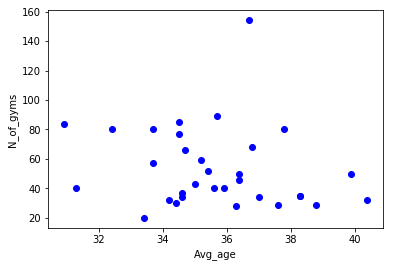

In [14]:
plt.scatter(df_data.Avg_age, df_data.N_of_gyms,  color='blue')
plt.xlabel("Avg_age")
plt.ylabel("N_of_gyms")
plt.show()

Since I'm interested in the relation between N° of gyms and the other features lets plot each of these features vs N° of gyms

In [15]:
mask = np.random.rand(len(df_data)) < 0.8
train =df_data[mask]
test = df_data[~mask]

In [16]:
l_regr = linear_model.LinearRegression()
train_x1 = np.asanyarray(train[['Population_2021']])
train_x2 = np.asanyarray(train[['Avg_age']])
train_x3 = np.asanyarray(train[['Pop_per_Km_square']])
train_x4 = np.asanyarray(train[['Avarege_Income']])
train_x5 = np.asanyarray(train[['Borough_extension']])

train_y = np.asanyarray(train[['N_of_gyms']])


POPULATION 2021 vs N° OF GYMS

In [17]:
l_regr.fit(train_x1, train_y)
# The coefficients
print ('Coefficients: ', l_regr.coef_)
print ('Intercept: ',l_regr.intercept_)

Coefficients:  [[1.35368583e-05]]
Intercept:  [53.17921632]


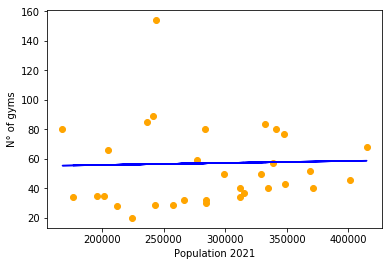

In [18]:
plt.scatter(df_data.Population_2021, df_data.N_of_gyms, color='orange')
plt.plot(train_x1, l_regr.coef_[0][0]*train_x1 + l_regr.intercept_[0], '-b')
plt.xlabel("Population 2021")
plt.ylabel("N° of gyms")
plt.show()

In [19]:
test_x = np.asanyarray(test[['Population_2021']])
test_y = np.asanyarray(test[['N_of_gyms']])
test_y_hat = l_regr.predict(test_x)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y_hat , test_y) )

Mean absolute error: 16.43
Residual sum of squares (MSE): 371.30
R2-score: -823.59


Definetly not very linear, lets try with a polynomial regression

Coefficients:  [[ 0.00000000e+00  1.03813846e-03 -3.59834939e-09  4.05550154e-15]]
Intercept:  [-39.94966937]
Mean absolute error: 16.17
Residual sum of squares (MSE): 371.74
R2-score: -1350.89


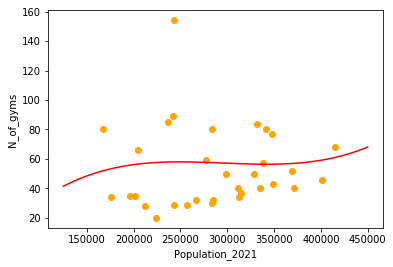

In [20]:
from sklearn.preprocessing import PolynomialFeatures

train_y = np.asanyarray(train[['N_of_gyms']])

#test_x = np.asanyarray(test[['Population_2021']])
#test_y = np.asanyarray(test[['N_of_gyms']])

l_regr = linear_model.LinearRegression()
poly = PolynomialFeatures(degree=3)

train_x1_poly = poly.fit_transform(train_x1)
#print(train_x1_poly)
#clf_x1 = linear_model.LinearRegression()
train_y1_poly = l_regr.fit(train_x1_poly, train_y)
# The coefficients
print ('Coefficients: ', l_regr.coef_)
print ('Intercept: ', l_regr.intercept_)

plt.scatter(df_data.Population_2021, df_data.N_of_gyms, color='orange')
XX1 = np.arange(125000.0, 450000.0, 10.0)
yy1 = l_regr.intercept_[0]+ l_regr.coef_[0][1]*XX1+ l_regr.coef_[0][2]*np.power(XX1, 2)+l_regr.coef_[0][3]*np.power(XX1, 3)#+l_regr.coef_[0][4]*np.power(XX1, 4)

plt.xlabel("Population_2021")
plt.ylabel("N_of_gyms")
plt.plot(XX1, yy1, '-r' )

test_x1_poly = poly.fit_transform(test_x)
test_y1_poly_hat = l_regr.predict(test_x1_poly)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y1_poly_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y1_poly_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y1_poly_hat , test_y) )

A little better but still not so good

AVG AGE vs N° OF GYMS

In [21]:
l_regr = linear_model.LinearRegression()
l_regr.fit(train_x2, train_y)
# The coefficients
print ('Coefficients: ', l_regr.coef_)
print ('Intercept: ',l_regr.intercept_)

Coefficients:  [[-2.76338028]]
Intercept:  [155.70794366]


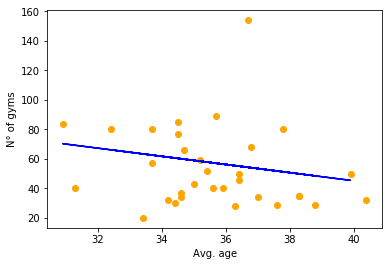

In [22]:
plt.scatter(df_data.Avg_age, df_data.N_of_gyms, color='orange')
plt.plot(train_x2, l_regr.coef_[0][0]*train_x2 + l_regr.intercept_[0], '-b')
plt.xlabel("Avg. age")
plt.ylabel("N° of gyms")
plt.show()

In [23]:
test_x = np.asanyarray(test[['Avg_age']])
test_y = np.asanyarray(test[['N_of_gyms']])
test_y_hat = l_regr.predict(test_x)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y_hat , test_y) )

Mean absolute error: 16.77
Residual sum of squares (MSE): 390.64
R2-score: -6.71


Lets try polynomial regression

Coefficients:  [[ 0.00000000e+00 -1.39629797e+03  3.95139831e+01 -3.72303449e-01]]
Intercept:  [16485.43829635]
Mean absolute error: 17.64
Residual sum of squares (MSE): 473.03
R2-score: -0.83


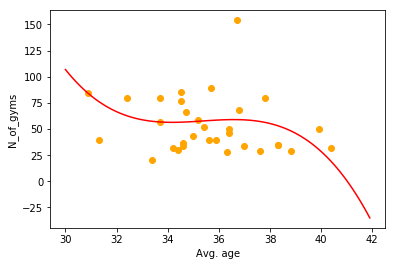

In [24]:
train_y = np.asanyarray(train[['N_of_gyms']])

#test_x = np.asanyarray(test[['Population_2021']])
#test_y = np.asanyarray(test[['N_of_gyms']])

l_regr = linear_model.LinearRegression()
poly = PolynomialFeatures(degree=3)

train_x2_poly = poly.fit_transform(train_x2)
#print(train_x1_poly)
#clf_x1 = linear_model.LinearRegression()
train_y2_poly = l_regr.fit(train_x2_poly, train_y)
# The coefficients
print ('Coefficients: ', l_regr.coef_)
print ('Intercept: ', l_regr.intercept_)

plt.scatter(df_data.Avg_age, df_data.N_of_gyms, color='orange')
XX1 = np.arange(30, 42.0, 0.1)
yy1 = l_regr.intercept_[0]+ l_regr.coef_[0][1]*XX1+ l_regr.coef_[0][2]*np.power(XX1, 2)+l_regr.coef_[0][3]*np.power(XX1, 3)#+l_regr.coef_[0][4]*np.power(XX1, 4)

plt.xlabel("Avg. age")
plt.ylabel("N_of_gyms")
plt.plot(XX1, yy1, '-r' )

test_x2_poly = poly.fit_transform(test_x)
test_y2_poly_hat = l_regr.predict(test_x2_poly)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y2_poly_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y2_poly_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y2_poly_hat , test_y) )

We can observe that the R-square paremeter is getting better, but its still negative.

POPULATION PER SQUARE KM vs N° OF GYMS

In [25]:
l_regr.fit (train_x3, train_y)
# The coefficients
print ('Coefficients: ', l_regr.coef_)

print ('Intercept: ',l_regr.intercept_)

Coefficients:  [[0.00455568]]
Intercept:  [19.35329813]


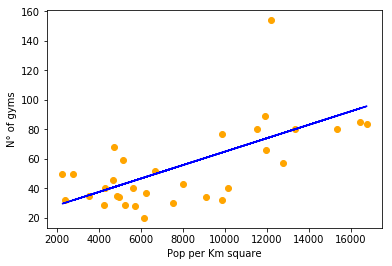

In [26]:
plt.scatter(df_data.Pop_per_Km_square, df_data.N_of_gyms, color='orange')
plt.plot(train_x3, l_regr.coef_[0][0]*train_x3 + l_regr.intercept_[0], '-b')
plt.xlabel("Pop per Km square")
plt.ylabel("N° of gyms")
plt.show()

In [27]:
test_x = np.asanyarray(test[['Pop_per_Km_square']])
test_y = np.asanyarray(test[['N_of_gyms']])
test_y_hat = l_regr.predict(test_x)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y_hat , test_y) )

Mean absolute error: 15.65
Residual sum of squares (MSE): 338.25
R2-score: -0.40


This one is not exeptionally good but it is possible to see a linear behaviour

AVAREGE INCOME vs N° OF GYMS

In [28]:
l_regr.fit (train_x4, train_y)
# The coefficients
print ('Coefficients: ', l_regr.coef_)
print ('Intercept: ',l_regr.intercept_)

Coefficients:  [[0.20687627]]
Intercept:  [-91.90457452]


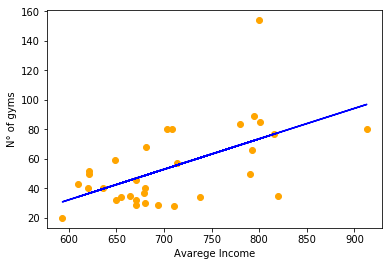

In [29]:
plt.scatter(df_data.Avarege_Income, df_data.N_of_gyms, color='orange')
plt.plot(train_x4, l_regr.coef_[0][0]*train_x4 + l_regr.intercept_[0], '-b')
plt.xlabel("Avarege Income")
plt.ylabel("N° of gyms")
plt.show()

In [30]:
test_x = np.asanyarray(test[['Avarege_Income']])
test_y = np.asanyarray(test[['N_of_gyms']])
test_y_hat = l_regr.predict(test_x)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y_hat , test_y) )

Mean absolute error: 9.89
Residual sum of squares (MSE): 176.02
R2-score: -2.67


Lets try the polynomial regression

Coefficients:  [[ 0.00000000e+00  7.09282825e-01 -3.40584683e-04]]
Intercept:  [-274.97105744]
Mean absolute error: 10.61
Residual sum of squares (MSE): 196.20
R2-score: -1.76


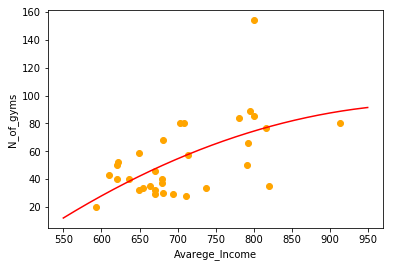

In [31]:
train_y = np.asanyarray(train[['N_of_gyms']])

#test_x = np.asanyarray(test[['Population_2021']])
#test_y = np.asanyarray(test[['N_of_gyms']])

l_regr = linear_model.LinearRegression()
poly = PolynomialFeatures(degree=2)

train_x4_poly = poly.fit_transform(train_x4)
#print(train_x1_poly)
#clf_x1 = linear_model.LinearRegression()
train_y4_poly = l_regr.fit(train_x4_poly, train_y)
# The coefficients
print ('Coefficients: ', l_regr.coef_)
print ('Intercept: ', l_regr.intercept_)

plt.scatter(df_data.Avarege_Income, df_data.N_of_gyms, color='orange')
XX1 = np.arange(550.0, 950.0, 0.5)
yy1 = l_regr.intercept_[0]+ l_regr.coef_[0][1]*XX1+ l_regr.coef_[0][2]*np.power(XX1, 2)#+l_regr.coef_[0][3]*np.power(XX1, 3)#+l_regr.coef_[0][4]*np.power(XX1, 4)

plt.xlabel("Avarege_Income")
plt.ylabel("N_of_gyms")
plt.plot(XX1, yy1, '-r' )

test_x4_poly = poly.fit_transform(test_x)
test_y4_poly_hat = l_regr.predict(test_x4_poly)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y4_poly_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y4_poly_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y4_poly_hat , test_y) )

BOROUGH EXTENSION vs N° OF GYMS

In [32]:
l_regr.fit (train_x5, train_y)
# The coefficients
print ('Coefficients: ', l_regr.coef_)
print ('Intercept: ',l_regr.intercept_)

Coefficients:  [[-0.30779873]]
Intercept:  [71.58105648]


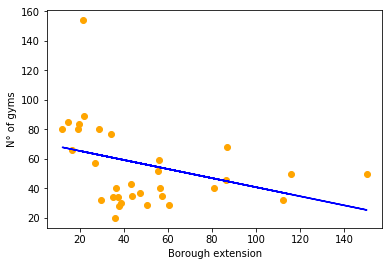

In [33]:
plt.scatter(df_data.Borough_extension, df_data.N_of_gyms, color='orange')
plt.plot(train_x5, l_regr.coef_[0][0]*train_x5 + l_regr.intercept_[0], '-b')
plt.xlabel("Borough extension")
plt.ylabel("N° of gyms")
plt.show()

In [34]:
test_x = np.asanyarray(test[['Borough_extension']])
test_y = np.asanyarray(test[['N_of_gyms']])
test_y_hat = l_regr.predict(test_x)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y_hat , test_y) )

Mean absolute error: 14.55
Residual sum of squares (MSE): 327.08
R2-score: -3.17


This one feels like there is a decresing exponential behaviour

Lets see what happens

Coefficients:  [[ 0.         -1.71970225  0.00969273]]
Intercept:  [106.61304611]
Mean absolute error: 15.77
Residual sum of squares (MSE): 311.08
R2-score: -0.97


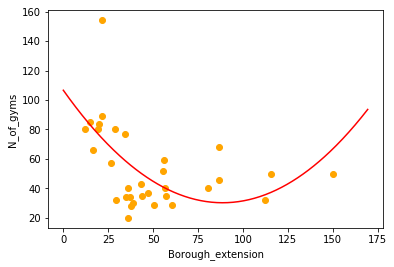

In [35]:
train_y = np.asanyarray(train[['N_of_gyms']])

#test_x = np.asanyarray(test[['Population_2021']])
#test_y = np.asanyarray(test[['N_of_gyms']])

l_regr = linear_model.LinearRegression()
poly = PolynomialFeatures(degree=2)

train_x5_poly = poly.fit_transform(train_x5)
#print(train_x1_poly)
#clf_x1 = linear_model.LinearRegression()
train_y5_poly = l_regr.fit(train_x5_poly, train_y)
# The coefficients
print ('Coefficients: ', l_regr.coef_)
print ('Intercept: ', l_regr.intercept_)

plt.scatter(df_data.Borough_extension, df_data.N_of_gyms, color='orange')
XX1 = np.arange(0.0, 170.0, 0.5)
yy1 = l_regr.intercept_[0]+ l_regr.coef_[0][1]*XX1+ l_regr.coef_[0][2]*np.power(XX1, 2)#+l_regr.coef_[0][3]*np.power(XX1, 3)#+l_regr.coef_[0][4]*np.power(XX1, 4)

plt.xlabel("Borough_extension")
plt.ylabel("N_of_gyms")
plt.plot(XX1, yy1, '-r' )

test_x5_poly = poly.fit_transform(test_x)
test_y5_poly_hat = l_regr.predict(test_x5_poly)

print("Mean absolute error: %.2f" % np.mean(np.absolute(test_y5_poly_hat - test_y)))
print("Residual sum of squares (MSE): %.2f" % np.mean((test_y5_poly_hat - test_y) ** 2))
print("R2-score: %.2f" % r2_score(test_y5_poly_hat , test_y) )

Now lets see if we can predicting Number of gyms using Pop per Km square, Avg_income, Borough_extension of London boroughs using MULTIPLE LINEAR REGRESSION. Im using this data because, after a few tries they seems to be the most significant for our prediction.

In [36]:
df_data.head()

,London borough,Latitude,Longitude,Population_2021,Avg_age,Pop_per_Km_square,Avarege_Income,Borough_extension,N_of_gyms
0,Camden,51.546413,-0.157423,241603.0,35.7,11902.36,794.7,21.789295,89
1,Greenwich,51.474430,0.055545,315207.0,34.6,6228.88,679.3,47.333867,37
2,Hackney,51.552264,-0.063312,283975.0,32.4,15330.08,703.7,19.049025,80
3,Hammersmith,51.495007,-0.220789,204671.0,34.7,11951.92,792.6,16.397453,66
4,Islington,51.548487,-0.110246,236760.0,34.5,16448.65,800.8,14.856656,85


In [37]:
#scaled_features = df_data.drop(['London borough'], axis=1)

In [38]:
#scaled_features.head()

In [39]:
#scaled_features = StandardScaler().fit_transform(scaled_features.values)

In [40]:
#print(scaled_features)

In [50]:
from sklearn import linear_model
l_regr = linear_model.LinearRegression()
msk = np.random.rand(len(df_data)) < 0.90
train = df_data[msk]
test = df_data[~msk]
print(train.shape, test.shape)

(27, 9) (5, 9)


In [51]:
x = np.asanyarray(train[['Pop_per_Km_square', 'Avarege_Income', 'Borough_extension']])
y = np.asanyarray(train[['N_of_gyms']])
l_regr.fit (x, y)
print ('Coefficients: ', l_regr.coef_)

Coefficients:  [[0.004648   0.11608767 0.27293769]]


In [52]:
test_y_mult_hat = l_regr.predict(test[['Pop_per_Km_square', 'Avarege_Income','Borough_extension']])
x = np.asanyarray(test[['Pop_per_Km_square', 'Avarege_Income', 'Borough_extension']])
y = np.asanyarray(test[['N_of_gyms']])

print(test_y_mult_hat)

print("Residual sum of squares: %.2f"
      % np.mean((test_y_mult_hat - y) ** 2))

# Explained variance score: 1 is perfect prediction
print('Variance score: %.2f' % l_regr.score(x, y))

[[75.13131383]
 [49.58308315]
 [28.87242974]
 [37.39834549]
 [48.95205314]]
Residual sum of squares: 143.06
Variance score: 0.74


Lets apply this model to see if the number of gyms per borough match the prediction. The variance is has huge variation which are due to the different train arrays. The train arrays are generated randomly with the data. Usually the variation does not indicated that this is a good model. Unfortunatly A set of 32 entries does not leave enough room for training the model.


In [53]:
y_hat_multi=l_regr.predict(df_data[['Pop_per_Km_square', 'Avarege_Income', 'Borough_extension']])
print(y_hat_multi)

[[75.13131383]
 [42.33651166]
 [79.75147167]
 [73.64624791]
 [95.07844742]
 [92.82710801]
 [71.07672984]
 [49.58308315]
 [65.34294025]
 [95.47526694]
 [71.48436195]
 [77.07390935]
 [28.87242974]
 [46.3759222 ]
 [35.71969275]
 [41.48955899]
 [64.86133557]
 [44.76752133]
 [39.87456835]
 [37.39834549]
 [53.30646319]
 [40.14437856]
 [38.71871353]
 [38.11053372]
 [36.04091264]
 [40.47288962]
 [40.93114619]
 [50.60139916]
 [42.00253068]
 [48.95205314]
 [33.26034116]
 [46.22909738]]


In [54]:
df_data['Predicted_N_of_gyms_multi']=y_hat_multi
#df_data['London borough']=London_borough_list

In [55]:
df_data.head()

,London borough,Latitude,Longitude,Population_2021,Avg_age,Pop_per_Km_square,Avarege_Income,Borough_extension,N_of_gyms,Predicted_N_of_gyms_multi
0,Camden,51.546413,-0.157423,241603.0,35.7,11902.36,794.7,21.789295,89,75.131314
1,Greenwich,51.474430,0.055545,315207.0,34.6,6228.88,679.3,47.333867,37,42.336512
2,Hackney,51.552264,-0.063312,283975.0,32.4,15330.08,703.7,19.049025,80,79.751472
3,Hammersmith,51.495007,-0.220789,204671.0,34.7,11951.92,792.6,16.397453,66,73.646248
4,Islington,51.548487,-0.110246,236760.0,34.5,16448.65,800.8,14.856656,85,95.078447


In [56]:
df_barchart_multi = df_data.drop(['Population_2021', 'Avg_age', 'Pop_per_Km_square', 'Avarege_Income', 'Borough_extension', 'Latitude', 'Longitude'], axis=1)
df_barchart_multi.set_index('London borough', inplace=True)
df_barchart_multi.head()

,N_of_gyms,Predicted_N_of_gyms_multi
London borough,,
Camden,89,75.131314
Greenwich,37,42.336512
Hackney,80,79.751472
Hammersmith,66,73.646248
Islington,85,95.078447


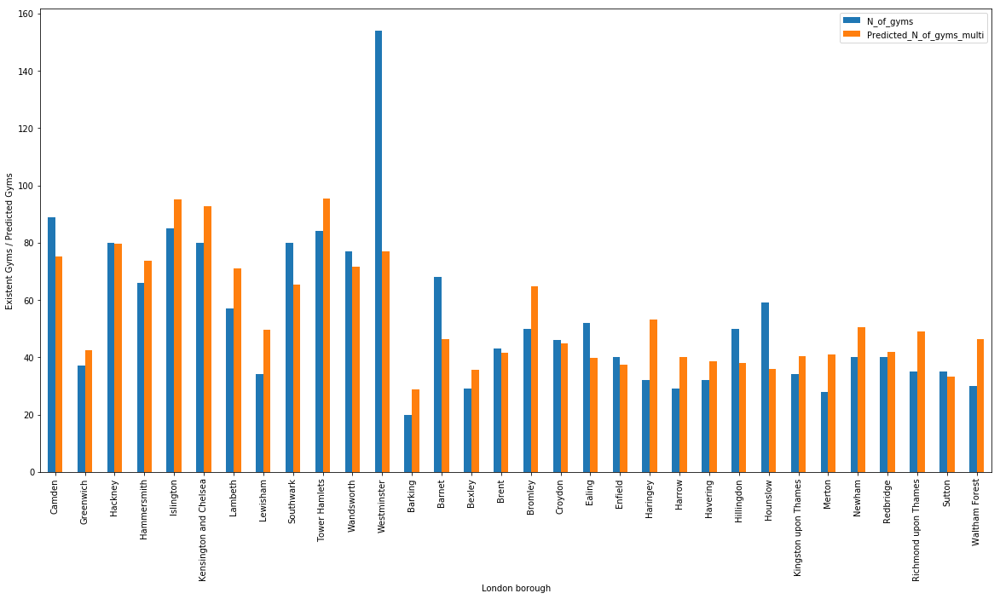

In [57]:
df_barchart_multi.plot(kind='bar', figsize=(20,10))
plt.ylabel('Existent Gyms / Predicted Gyms')
plt.show()

Lets try RandomForestRegressor

In [66]:
from sklearn.ensemble import RandomForestRegressor
clf = RandomForestRegressor(n_estimators=60)

msk = np.random.rand(len(df_data)) < 0.95
train = df_data[msk]
test = df_data[~msk]
print(train.shape, test.shape)

(31, 10) (1, 10)


In [67]:
x = np.asanyarray(train[['Pop_per_Km_square', 'Avarege_Income', 'Borough_extension']])
y = np.asanyarray(train[['N_of_gyms']])

In [68]:
clf.fit(x, y.ravel())

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators=60, n_jobs=None,
           oob_score=False, random_state=None, verbose=0, warm_start=False)

In [69]:
print('Variance score: %.2f' % clf.score(x, y))

Variance score: 0.92


Variance score of above 85%. This model is very good.Lets apply this model to see if the number of gyms per borough match the prediction.

In [70]:
y_hat_forrest=clf.predict(df_data[['Pop_per_Km_square', 'Avarege_Income', 'Borough_extension']])
print(y_hat_forrest)

[ 92.21666667  36.          80.8         77.23333333  85.7
  81.9         72.86666667  38.38333333  62.7         83.78333333
  61.58333333 128.38333333  28.11666667  59.55        32.93333333
  41.5         50.63333333  47.8         49.03333333  44.6
  38.78333333  35.68333333  39.78333333  48.18333333  51.61666667
  36.18333333  32.91666667  45.46666667  40.65        41.35
  35.15        31.86666667]


In [71]:
df_data['Predicted_N_of_gyms_forrest']=y_hat_forrest

In [72]:
df_data.head()

,London borough,Latitude,Longitude,Population_2021,Avg_age,Pop_per_Km_square,Avarege_Income,Borough_extension,N_of_gyms,Predicted_N_of_gyms_multi,Predicted_N_of_gyms_forrest
0,Camden,51.546413,-0.157423,241603.0,35.7,11902.36,794.7,21.789295,89,75.131314,92.216667
1,Greenwich,51.474430,0.055545,315207.0,34.6,6228.88,679.3,47.333867,37,42.336512,36.000000
2,Hackney,51.552264,-0.063312,283975.0,32.4,15330.08,703.7,19.049025,80,79.751472,80.800000
3,Hammersmith,51.495007,-0.220789,204671.0,34.7,11951.92,792.6,16.397453,66,73.646248,77.233333
4,Islington,51.548487,-0.110246,236760.0,34.5,16448.65,800.8,14.856656,85,95.078447,85.700000


In [26]:
#project.save_data(data=df_data.to_csv(index=False), file_name='df_data_final.csv',overwrite=True)

{'file_name': 'df_data_final.csv',
 'message': 'File saved to project storage.',
 'bucket_name': 'courseracapstoneprojectibmsec-donotdelete-pr-bxdirwxiww2cya',
 'asset_id': '1c619ee8-4fe0-4f20-ad2c-e2d2fa266f98'}

In [76]:
df_barchart_forest = df_data.drop(['Population_2021', 'Avg_age', 'Pop_per_Km_square', 'Avarege_Income', 'Borough_extension', 'Latitude', 'Longitude', 'Predicted_N_of_gyms_multi'], axis=1)
df_barchart_forest.set_index('London borough', inplace=True)

In [77]:
df_barchart = df_data.drop(['Population_2021', 'Avg_age', 'Pop_per_Km_square', 'Avarege_Income', 'Borough_extension', 'Latitude', 'Longitude'], axis=1)
df_barchart.set_index('London borough', inplace=True)

In [78]:
df_barchart_forest.head()

,N_of_gyms,Predicted_N_of_gyms_forrest
London borough,,
Camden,89,92.216667
Greenwich,37,36.000000
Hackney,80,80.800000
Hammersmith,66,77.233333
Islington,85,85.700000


In [79]:
df_barchart.head()

,N_of_gyms,Predicted_N_of_gyms_multi,Predicted_N_of_gyms_forrest
London borough,,,
Camden,89,75.131314,92.216667
Greenwich,37,42.336512,36.000000
Hackney,80,79.751472,80.800000
Hammersmith,66,73.646248,77.233333
Islington,85,95.078447,85.700000


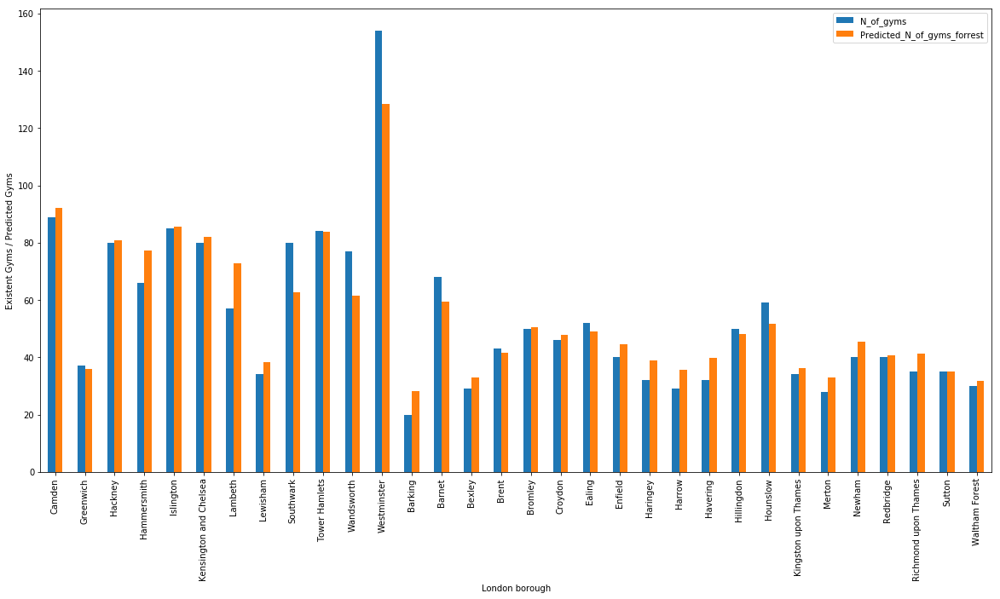

In [80]:
df_barchart_forest.plot(kind='bar', figsize=(20,10))
plt.ylabel('Existent Gyms / Predicted Gyms')
plt.show()

In [227]:
#project.save_data(data=df_barchart.to_csv(index=False), file_name='df_barchart_backup.csv',overwrite=True)

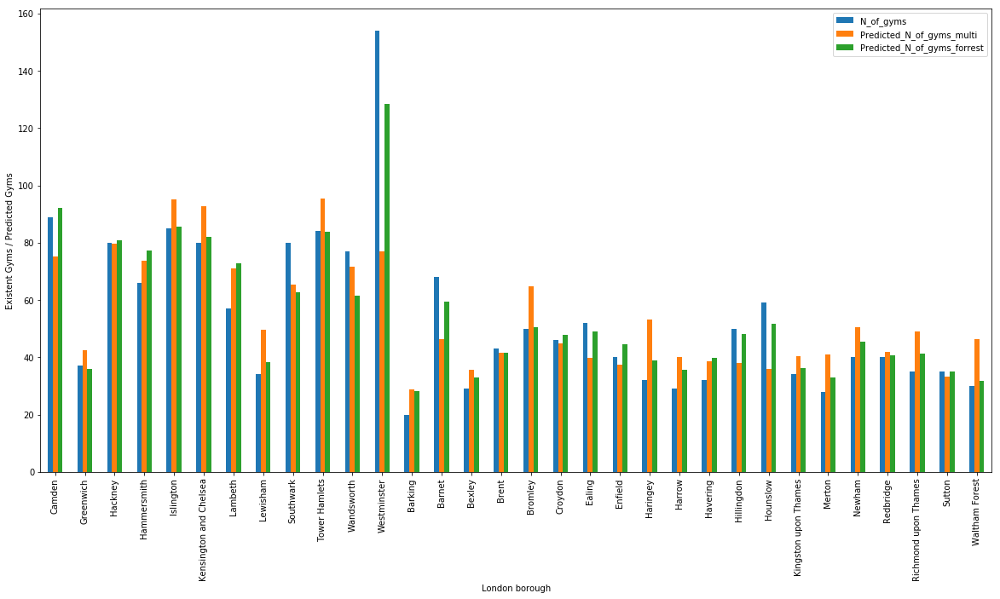

In [81]:
df_barchart.plot(kind='bar', figsize=(20,10))
plt.ylabel('Existent Gyms / Predicted Gyms')
plt.show()

Number of predicted gyms and existing ones vs the average income

In [82]:
df_area_avg_income = df_data.drop(['Population_2021', 'Pop_per_Km_square', 'London borough', 'Avg_age', 'Borough_extension', 'Latitude', 'Longitude'], axis=1)
df_area_avg_income.sort_values(by=['Avarege_Income'], inplace=True)
df_area_avg_income.set_index('Avarege_Income', inplace=True)
df_area_avg_income.head()

,N_of_gyms,Predicted_N_of_gyms_multi,Predicted_N_of_gyms_forrest
Avarege_Income,,,
593.5,20,28.872430,28.116667
610.2,43,41.489559,41.500000
620.2,40,50.601399,45.466667
621.0,50,38.110534,48.183333
621.7,52,39.874568,49.033333


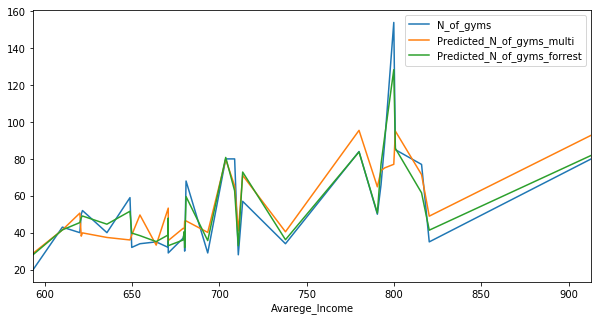

In [83]:
df_area_avg_income.plot(kind='line', stacked=False, figsize=(10, 5))

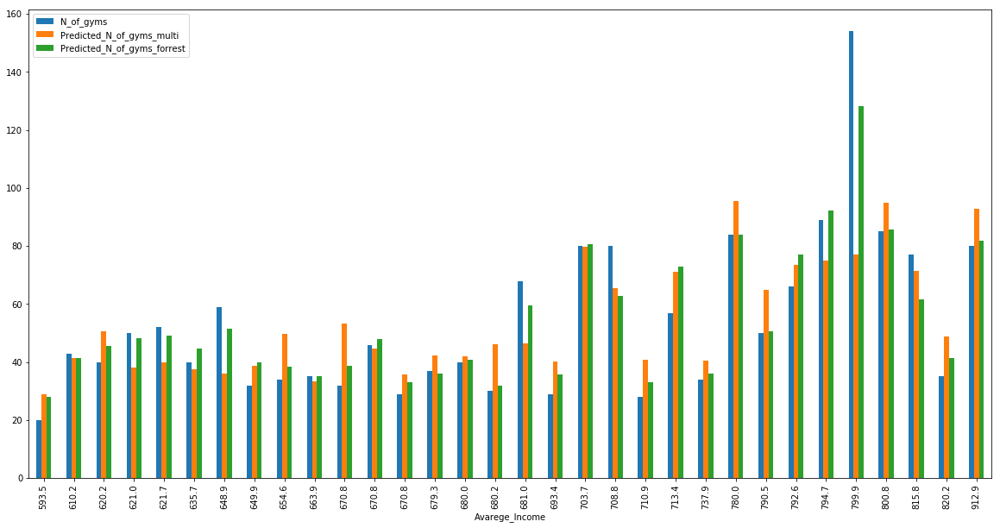

In [84]:
df_area_avg_income.plot(kind='bar', stacked=False, figsize=(20, 10))

DBSCAN experiment

Clustering of gyms based on their location and gym density

In [ ]:
#df_data.head()

In [88]:
#sklearn.utils.check_random_state(1000)
#Clus_dataSet = df_data[['Latitude','Longitude','N_of_gyms','Predicted_N_of_gyms']]
#Clus_dataSet = StandardScaler().fit_transform(Clus_dataSet)

# Compute DBSCAN
#db = DBSCAN(eps=0.3, min_samples=10).fit(Clus_dataSet)
#core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
#core_samples_mask[db.core_sample_indices_] = True
#labels = db.labels_
#df_data["Clus_Db"]=labels

#realClusterNum=len(set(labels)) - (1 if -1 in labels else 0)
#clusterNum = len(set(labels)) 


# A sample of clusters
#df_data.head(5)

In [85]:
df_barchart.head()

,N_of_gyms,Predicted_N_of_gyms_multi,Predicted_N_of_gyms_forrest
London borough,,,
Camden,89,75.131314,92.216667
Greenwich,37,42.336512,36.000000
Hackney,80,79.751472,80.800000
Hammersmith,66,73.646248,77.233333
Islington,85,95.078447,85.700000


In [86]:
list_var=[]
for k in range(0, len(df_barchart)):
    Existing_gyms=df_barchart['N_of_gyms'].iloc[k]
    #print(Existing_gyms)
    Predicted_gyms=df_barchart['Predicted_N_of_gyms_forrest'].iloc[k]
    #RMS=
    #rms_list.append(np.sqrt(0.5*(Existing_gyms**2+Predicted_gyms**2)))
    list_var.append(Existing_gyms-Predicted_gyms)
    
print(list_var)

[-3.2166666666666686, 1.0, -0.7999999999999972, -11.233333333333334, -0.7000000000000028, -1.9000000000000057, -15.86666666666666, -4.383333333333333, 17.299999999999997, 0.21666666666666856, 15.416666666666664, 25.616666666666674, -8.116666666666667, 8.450000000000003, -3.93333333333333, 1.5, -0.6333333333333329, -1.7999999999999972, 2.9666666666666686, -4.600000000000001, -6.783333333333331, -6.68333333333333, -7.783333333333331, 1.81666666666667, 7.383333333333333, -2.18333333333333, -4.916666666666664, -5.466666666666669, -0.6499999999999986, -6.350000000000001, -0.14999999999999858, -1.8666666666666671]


In [87]:
df_variation=df_barchart
df_variation=df_variation.drop(['Predicted_N_of_gyms_multi'], axis=1)
df_variation['variation']=list_var
df_variation.head()

,N_of_gyms,Predicted_N_of_gyms_forrest,variation
London borough,,,
Camden,89,92.216667,-3.216667
Greenwich,37,36.000000,1.000000
Hackney,80,80.800000,-0.800000
Hammersmith,66,77.233333,-11.233333
Islington,85,85.700000,-0.700000


In [88]:
df_variation_plot=df_variation.drop(['N_of_gyms','Predicted_N_of_gyms_forrest'], axis=1)
df_variation_plot.head()

,variation
London borough,
Camden,-3.216667
Greenwich,1.000000
Hackney,-0.800000
Hammersmith,-11.233333
Islington,-0.700000


In [89]:
df_variation_plot.head()

,variation
London borough,
Camden,-3.216667
Greenwich,1.000000
Hackney,-0.800000
Hammersmith,-11.233333
Islington,-0.700000


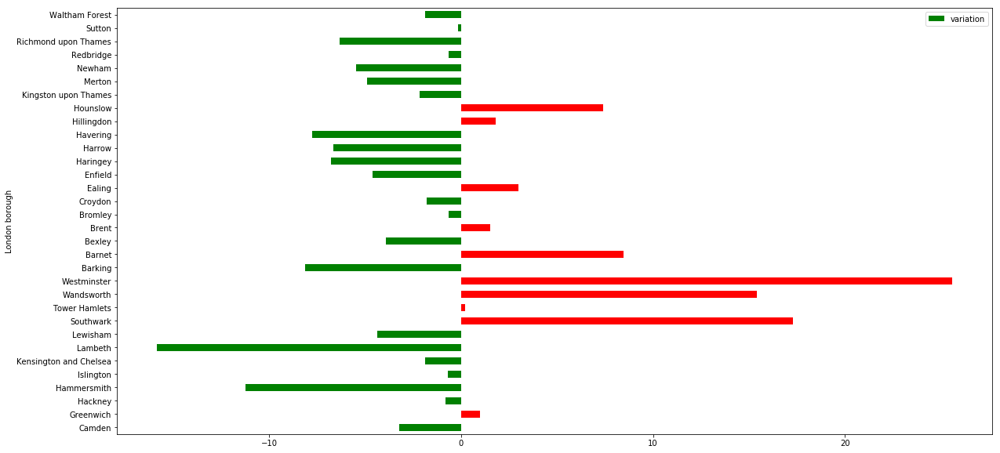

In [90]:
def bar_color(df,color1,color2):
    return np.where(df_variation_plot.values>0,color1,color2).T

df_variation_plot.plot(kind='barh', stacked=False, figsize=(20,10), color=bar_color(df_variation,'r','g'))

In [91]:
df_data.head()

,London borough,Latitude,Longitude,Population_2021,Avg_age,Pop_per_Km_square,Avarege_Income,Borough_extension,N_of_gyms,Predicted_N_of_gyms_multi,Predicted_N_of_gyms_forrest
0,Camden,51.546413,-0.157423,241603.0,35.7,11902.36,794.7,21.789295,89,75.131314,92.216667
1,Greenwich,51.474430,0.055545,315207.0,34.6,6228.88,679.3,47.333867,37,42.336512,36.000000
2,Hackney,51.552264,-0.063312,283975.0,32.4,15330.08,703.7,19.049025,80,79.751472,80.800000
3,Hammersmith,51.495007,-0.220789,204671.0,34.7,11951.92,792.6,16.397453,66,73.646248,77.233333
4,Islington,51.548487,-0.110246,236760.0,34.5,16448.65,800.8,14.856656,85,95.078447,85.700000


In [92]:
london_geo = f'https://raw.githubusercontent.com/Kloppersx/London_boroughs_geo/main/combined_boroughs.json'
#london_geo = f'https://raw.githubusercontent.com/Kloppersx/London_boroughs_geo/main/' + df_borough['London borough'].iloc[0] + '.json'
 
# create a plain world map
choro_number_gyms = folium.Map(
    location=[51.5194, 0.1270],
    tiles='Stamen toner',
    zoom_start=10 
)

In [93]:
threshold_scale = np.linspace(df_data['N_of_gyms'].min(),
                              df_data['N_of_gyms'].max(),
                              10, dtype=int)
threshold_scale = threshold_scale.tolist()
threshold_scale[-1] = threshold_scale[-1] + 1 

In [94]:
folium.Choropleth(
    geo_data=london_geo,
    name='choropleth',
    data=df_data,
    columns=['London borough', 'N_of_gyms'],
    key_on='feature.properties.name',
    threshold_scale=threshold_scale,
    fill_color='Reds',
    fill_opacity=0.95,
    line_opacity=0.5,
    legend_name='Number of gyms'
).add_to(choro_number_gyms)

folium.LayerControl().add_to(choro_number_gyms)

choro_number_gyms

In [96]:
choro_predicted_gyms = folium.Map(
    location=[51.5194, 0.1270],
    tiles='Stamen toner',
    zoom_start=10 
)
threshold_scale = np.linspace(df_data['Predicted_N_of_gyms_forrest'].min(),
                              df_data['Predicted_N_of_gyms_forrest'].max(),
                              10, dtype=int)
threshold_scale = threshold_scale.tolist()
threshold_scale[-1] = threshold_scale[-1] + 1 

In [97]:
folium.Choropleth(
    geo_data=london_geo,
    name='choropleth',
    data=df_data,
    columns=['London borough', 'Predicted_N_of_gyms_forrest'],
    key_on='feature.properties.name',
    threshold_scale=threshold_scale,
    fill_color='Reds',
    fill_opacity=0.95,
    line_opacity=0.5,
    legend_name='Predicted number of gyms - Random Forrest Regression'
).add_to(choro_predicted_gyms)

folium.LayerControl().add_to(choro_predicted_gyms)

choro_predicted_gyms

In [99]:
df_variation_raw = df_data.drop(['Population_2021', 'Avg_age', 'Pop_per_Km_square', 'Avarege_Income', 'Borough_extension', 'Latitude', 'Longitude','Predicted_N_of_gyms_multi','Predicted_N_of_gyms_forrest','N_of_gyms'], axis=1)
df_variation_raw.head()

,London borough
0,Camden
1,Greenwich
2,Hackney
3,Hammersmith
4,Islington


In [100]:
df_variation_raw['variation']=list_var

In [101]:
df_variation_raw.head()

,London borough,variation
0,Camden,-3.216667
1,Greenwich,1.000000
2,Hackney,-0.800000
3,Hammersmith,-11.233333
4,Islington,-0.700000


In [102]:
df_variation_choro=pd.DataFrame(columns=['London borough', 'variation'])
df_variation_choro.head()

,London borough,variation


In [103]:
var_list_negative=[]
borough_list=[]

for i in range (len(df_variation_raw)):
    if df_variation_raw['variation'].iloc[i] < 0:
        #print('yo')
        borough_list.append(df_variation_raw['London borough'].iloc[i])
        var_list_negative.append(df_variation_raw['variation'].iloc[i])
    if df_variation_raw['variation'].iloc[i] > 0:
            borough_list.append(df_variation_raw['London borough'].iloc[i])
            var_list_negative.append(0)

Trasforming negative to positive

In [104]:
var_list_negative = [ -x for x in var_list_negative]
df_variation_choro['variation']=var_list_negative
df_variation_choro['London borough']=borough_list

In [105]:
df_variation_choro.head(32)

,London borough,variation
0,Camden,3.216667
1,Greenwich,0.000000
2,Hackney,0.800000
3,Hammersmith,11.233333
4,Islington,0.700000
5,Kensington and Chelsea,1.900000
6,Lambeth,15.866667
7,Lewisham,4.383333
8,Southwark,0.000000
9,Tower Hamlets,0.000000


In [106]:
choro_variation = folium.Map(
    location=[51.5194, 0.1270],
    tiles='Stamen Toner',
    zoom_start=10 
)
threshold_scale = np.linspace(df_variation_choro['variation'].min(),
                              df_variation_choro['variation'].max(),
                              10, dtype=int)
threshold_scale = threshold_scale.tolist()
threshold_scale[-1] = threshold_scale[-1] + 1 

In [107]:
folium.Choropleth(
    geo_data=london_geo,
    name='choropleth',
    data=df_variation_choro,
    columns=['London borough', 'variation'],
    key_on='feature.properties.name',
    threshold_scale=threshold_scale,
    fill_color='Blues',
    fill_opacity=0.90,
    line_opacity=0.5,
    legend_name='Variation'
).add_to(choro_variation)

folium.LayerControl().add_to(choro_variation)

choro_variation

In [ ]:
#from sklearn.tree import DecisionTreeClassifier

In [ ]:
#list_positive=[]
#for k in range(0, len(df_variation)):
#    if df_variation['variation'].iloc[k] > 0:
#        list_positive.append('True')
#    else:
#        list_positive.append('False')
        
#print(list_positive)

In [ ]:
#df_data['Positive']=list_positive
#df_data.head()

Preprocessing

In [ ]:
#X = df_data[['Population_2021', 'Avg_age', 'Pop_per_Km_square', 'Avarege_Income', 'Borough_extension']].values
#X[0:5]

In [ ]:
#y = df_data['Positive']
#y[0:5]

In [ ]:
#from sklearn.model_selection import train_test_split
#X_trainset, X_testset, y_trainset, y_testset = train_test_split(X, y, test_size=0.3, random_state=3)
#print(X_trainset.shape)
#print(y_trainset.shape)

#print(X_testset.shape)
#print(y_testset.shape)

In [ ]:
#GymTree = DecisionTreeClassifier(criterion="entropy", max_depth = 4)
#GymTree # it shows the default parameters


In [ ]:
#GymTree.fit(X_trainset,y_trainset)

In [ ]:
#prediction_gym_Tree = GymTree.predict(X_testset)

In [ ]:
#print (prediction_gym_Tree [0:5])
#print (y_testset [0:5])

In [ ]:
#from sklearn import metrics
#import matplotlib.pyplot as plt
#print("DecisionTrees's Accuracy: ", metrics.accuracy_score(y_testset, prediction_gym_Tree))